[![Roboflow Notebooks](https://media.roboflow.com/notebooks/template/bannertest2-2.png?ik-sdk-version=javascript-1.4.3&updatedAt=1672932710194)](https://github.com/roboflow/notebooks)

# Segment Images with Segment Anything 2 (SAM2)

---

[![GitHub](https://badges.aleen42.com/src/github.svg)](https://github.com/facebookresearch/segment-anything-2)

Segment Anything Model 2 (SAM 2) is a foundation model designed to address promptable visual segmentation in both images and videos. The model extends its functionality to video by treating images as single-frame videos. Its design, a simple transformer architecture with streaming memory, enables real-time video processing. A model-in-the-loop data engine, which enhances the model and data through user interaction, was built to collect the SA-V dataset, the largest video segmentation dataset to date. SAM 2, trained on this extensive dataset, delivers robust performance across diverse tasks and visual domains.

![segment anything model](https://media.roboflow.com/notebooks/examples/segment-anything-model-2-paper.jpg)

This notebook is an extension of the official [notebook](https://github.com/facebookresearch/segment-anything-2/blob/main/notebooks/image_predictor_example.ipynb) prepared by Meta AI.

## Complementary materials

---

[![Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/roboflow-ai/notebooks/blob/main/notebooks/how-to-segment-images-with-sam-2.ipynb)
[![Roboflow](https://raw.githubusercontent.com/roboflow-ai/notebooks/main/assets/badges/roboflow-blogpost.svg)](https://blog.roboflow.com/what-is-segment-anything-2)

We recommend that you follow along in this notebook while reading the blog post on Segment Anything Model 2 (SAM2).

[![SAM2 blogpost](https://media.roboflow.com/notebooks/examples/blog-what-is-sam-2.png)](https://blog.roboflow.com/what-is-segment-anything-2)

## Setup

### Before you start

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [1]:
!nvidia-smi

Sat Apr  5 19:09:27 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   61C    P8             10W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

**NOTE:** To make it easier for us to manage datasets, images and models we create a `HOME` constant.

In [2]:
import os
HOME = os.getcwd()
print("HOME:", HOME)

HOME: /content


### Install SAM2 and dependencies

In [3]:
!git clone https://github.com/facebookresearch/segment-anything-2.git
%cd {HOME}/segment-anything-2
!pip install -e . -q

Cloning into 'segment-anything-2'...
remote: Enumerating objects: 1070, done.
remote: Counting objects: 100% (477/477), done.
remote: Compressing objects: 100% (198/198), done.
remote: Total 1070 (delta 322), reused 279 (delta 279), pack-reused 593 (from 1)
Receiving objects: 100% (1070/1070), 115.76 MiB | 11.89 MiB/s, done.
Resolving deltas: 100% (416/416), done.
/content/segment-anything-2
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 7.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 3.2 MB/s eta 0:

In [4]:
!pip install -q supervision jupyter_bbox_widget

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 181.5/181.5 kB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 220.7/220.7 kB 17.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 765.5/765.5 kB 29.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 35.2 MB/s eta 0:00:00


### Download SAM2 checkpoints

**NOTE:** SAM2 is available in 4 different model sizes ranging from the lightweight "sam2_hiera_tiny" (38.9M parameters) to the more powerful "sam2_hiera_large" (224.4M parameters).

In [5]:
!mkdir -p {HOME}/checkpoints
!wget -q https://dl.fbaipublicfiles.com/segment_anything_2/072824/sam2_hiera_tiny.pt -P {HOME}/checkpoints
!wget -q https://dl.fbaipublicfiles.com/segment_anything_2/072824/sam2_hiera_small.pt -P {HOME}/checkpoints
!wget -q https://dl.fbaipublicfiles.com/segment_anything_2/072824/sam2_hiera_base_plus.pt -P {HOME}/checkpoints
!wget -q https://dl.fbaipublicfiles.com/segment_anything_2/072824/sam2_hiera_large.pt -P {HOME}/checkpoints

### Download example data

**NONE:** Let's download few example images. Feel free to use your images or videos.

In [6]:
!mkdir -p {HOME}/data
!wget -q https://media.roboflow.com/notebooks/examples/dog.jpeg -P {HOME}/data
!wget -q https://media.roboflow.com/notebooks/examples/dog-2.jpeg -P {HOME}/data
!wget -q https://media.roboflow.com/notebooks/examples/dog-3.jpeg -P {HOME}/data
!wget -q https://media.roboflow.com/notebooks/examples/dog-4.jpeg -P {HOME}/data

### Imports

In [7]:
import cv2
import torch
import base64

import numpy as np
import supervision as sv

from sam2.build_sam import build_sam2
from sam2.sam2_image_predictor import SAM2ImagePredictor
from sam2.automatic_mask_generator import SAM2AutomaticMaskGenerator

**NOTE:** This code enables mixed-precision computing for faster deep learning. It uses bfloat16 for most calculations and, on newer NVIDIA GPUs, leverages TensorFloat-32 (TF32) for certain operations to further boost performance.

In [8]:
torch.autocast(device_type="cuda", dtype=torch.bfloat16).__enter__()

if torch.cuda.get_device_properties(0).major >= 8:
    torch.backends.cuda.matmul.allow_tf32 = True
    torch.backends.cudnn.allow_tf32 = True

## Load model





In [9]:
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
CHECKPOINT = f"{HOME}/checkpoints/sam2_hiera_large.pt"
CONFIG = "sam2_hiera_l.yaml"

sam2_model = build_sam2(CONFIG, CHECKPOINT, device=DEVICE, apply_postprocessing=False)

## Automated mask generation

Since SAM 2 can efficiently process prompts, masks for the entire image can be generated by sampling a large number of prompts over an image.

The class `SAM2AutomaticMaskGenerator` implements this capability. It works by sampling single-point input prompts in a grid over the image, from each of which SAM can predict multiple masks. Then, masks are filtered for quality and deduplicated using non-maximal suppression. Additional options allow for further improvement of mask quality and quantity, such as running prediction on multiple crops of the image or postprocessing masks to remove small disconnected regions and holes.

In [10]:
mask_generator = SAM2AutomaticMaskGenerator(sam2_model)

**NOTE:** OpenCV loads images in BGR format by default, so we convert to RGB for compatibility with the mask generator.

In [11]:
IMAGE_PATH = f"{HOME}/data/dog.jpeg"

image_bgr = cv2.imread(IMAGE_PATH)
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

sam2_result = mask_generator.generate(image_rgb)

### Output format

`SAM2AutomaticMaskGenerator` returns a `list` of masks, where each mask is a `dict` containing various information about the mask:

* `segmentation` - `[np.ndarray]` - the mask with `(W, H)` shape, and `bool` type
* `area` - `[int]` - the area of the mask in pixels
* `bbox` - `[List[int]]` - the boundary box of the mask in `xywh` format
* `predicted_iou` - `[float]` - the model's own prediction for the quality of the mask
* `point_coords` - `[List[List[float]]]` - the sampled input point that generated this mask
* `stability_score` - `[float]` - an additional measure of mask quality
* `crop_box` - `List[int]` - the crop of the image used to generate this mask in `xywh` format

### Results visualisation

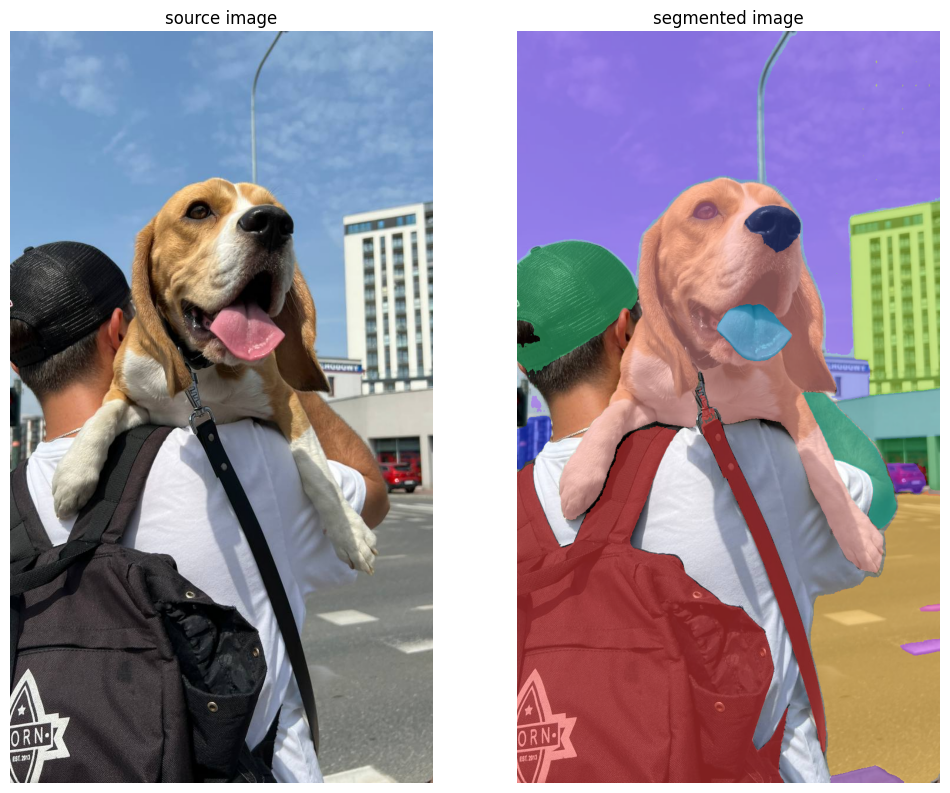

In [12]:
mask_annotator = sv.MaskAnnotator(color_lookup=sv.ColorLookup.INDEX)
detections = sv.Detections.from_sam(sam_result=sam2_result)

annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

sv.plot_images_grid(
    images=[image_bgr, annotated_image],
    grid_size=(1, 2),
    titles=['source image', 'segmented image']
)

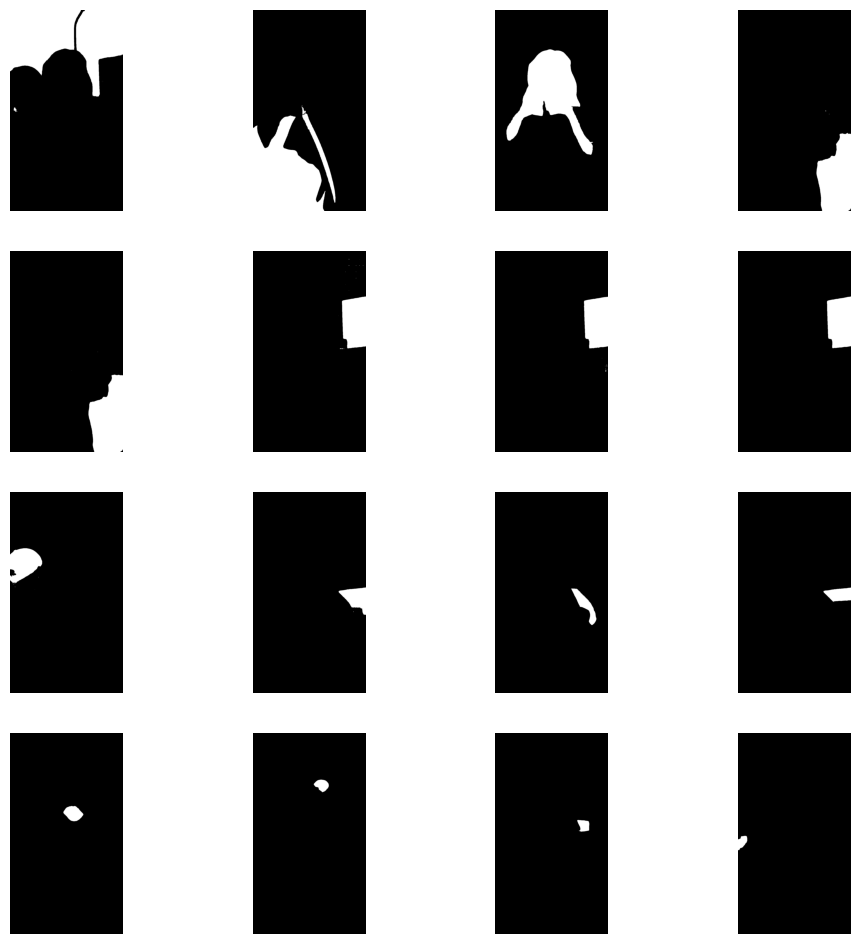

In [13]:
masks = [
    mask['segmentation']
    for mask
    in sorted(sam2_result, key=lambda x: x['area'], reverse=True)
]

sv.plot_images_grid(
    images=masks[:16],
    grid_size=(4, 4),
    size=(12, 12)
)

### Advanced automatic mask generation options

There are several tunable parameters in automatic mask generation that control how densely points are sampled and what the thresholds are for removing low quality or duplicate masks. Additionally, generation can be automatically run on crops of the image to get improved performance on smaller objects, and post-processing can remove stray pixels and holes.

- `points_per_side` `[int or None]` - the number of points to be sampled
along one side of the image. The total number of points is
`points_per_side**2`. If `None`, `point_grids` must provide explicit
point sampling.
- `points_per_batch` - `[int]` - sets the number of points run simultaneously
by the model. Higher numbers may be faster but use more GPU memory.
- `pred_iou_thresh` `[float]` - a filtering threshold in `[0,1]`, using the
model's predicted mask quality.
- `stability_score_thresh` - `[float]` - a filtering threshold in `[0,1]`, using
the stability of the mask under changes to the cutoff used to binarize
the model's mask predictions.
- `stability_score_offset` - `[float]` - the amount to shift the cutoff when
calculated the stability score.
- `mask_threshold` - `[float]` - threshold for binarizing the mask logits
- `box_nms_thresh` - `[float]` - the box IoU cutoff used by non-maximal
suppression to filter duplicate masks.
- `crop_n_layers` - `[int]` - if `>0`, mask prediction will be run again on
crops of the image. Sets the number of layers to run, where each
layer has `2**i_layer` number of image crops.
- `crop_nms_thresh` - `[float]` - the box IoU cutoff used by non-maximal
suppression to filter duplicate masks between different crops.
- `crop_overlap_ratio` - `[float]` - sets the degree to which crops overlap.
In the first crop layer, crops will overlap by this fraction of
the image length. Later layers with more crops scale down this overlap.
- `crop_n_points_downscale_factor` - `[int]` - the number of points-per-side
sampled in layer `n` is scaled down by `crop_n_points_downscale_factor**n`.
- `point_grids` - `[List[np.ndarray] or None]` - a list over explicit grids
of points used for sampling, normalized to `[0,1]`. The nth grid in the
list is used in the nth crop layer. Exclusive with points_per_side.
- `min_mask_region_area` - `[int]` - if `>0`, postprocessing will be applied
to remove disconnected regions and holes in masks with area smaller
than `min_mask_region_area`. Requires opencv.

In [14]:
mask_generator_2 = SAM2AutomaticMaskGenerator(
    model=sam2_model,
    points_per_side=64,
    points_per_batch=128,
    pred_iou_thresh=0.7,
    stability_score_thresh=0.92,
    stability_score_offset=0.7,
    crop_n_layers=1,
    box_nms_thresh=0.7,
)

In [15]:
sam2_result_2 = mask_generator_2.generate(image_rgb)

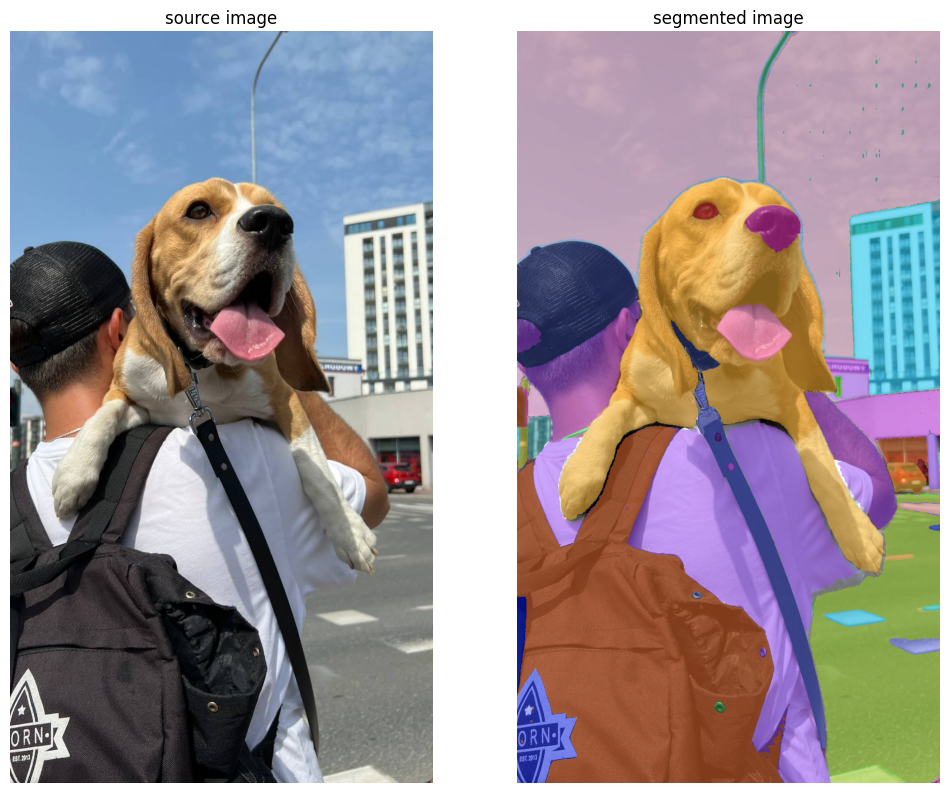

In [16]:
mask_annotator = sv.MaskAnnotator(color_lookup=sv.ColorLookup.INDEX)
detections = sv.Detections.from_sam(sam_result=sam2_result_2)

annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

sv.plot_images_grid(
    images=[image_bgr, annotated_image],
    grid_size=(1, 2),
    titles=['source image', 'segmented image']
)

## Prompting with boxes

The `SAM2ImagePredictor` class provides an easy interface to the model for prompting the model. It allows the user to first set an image using the `set_image` method, which calculates the necessary image embeddings. Then, prompts can be provided via the `predict` method to efficiently predict masks from those prompts. The model can take as input both point and box prompts, as well as masks from the previous iteration of prediction.

In [13]:
predictor = SAM2ImagePredictor(sam2_model)

In [21]:
#IMAGE_PATH = f"{HOME}/data/dog-2.jpeg"
IMAGE_PATH = '/content/4_m_0.jpg'
image_bgr = cv2.imread(IMAGE_PATH)
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

### Interactive box prompt

In [15]:
def encode_image(filepath):
    with open(filepath, 'rb') as f:
        image_bytes = f.read()
    encoded = str(base64.b64encode(image_bytes), 'utf-8')
    return "data:image/jpg;base64,"+encoded

**NOTE:** Execute cell below and use your mouse to **draw bounding box** on the image 👇

In [22]:
IS_COLAB = True

if IS_COLAB:
    from google.colab import output
    output.enable_custom_widget_manager()

from jupyter_bbox_widget import BBoxWidget

widget = BBoxWidget()
widget.image = encode_image(IMAGE_PATH)
widget

BBoxWidget(colors=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#b…

In [23]:
widget.bboxes

[{'x': 1, 'y': 148, 'width': 133, 'height': 440, 'label': ''}]

**NOTE:** `Sam2ImagePredictor.predict` method takes `np.ndarray` `box` argument in `[x_min, y_min, x_max, y_max]` format.

In [24]:
default_box = [
    {'x': 166, 'y': 835, 'width': 99, 'height': 175, 'label': ''},
    {'x': 472, 'y': 885, 'width': 168, 'height': 249, 'label': ''},
    {'x': 359, 'y': 727, 'width': 27, 'height': 155, 'label': ''},
    {'x': 164, 'y': 1044, 'width': 279, 'height': 163, 'label': ''}
]

boxes = widget.bboxes if widget.bboxes else default_box
boxes = np.array([
    [
        box['x'],
        box['y'],
        box['x'] + box['width'],
        box['y'] + box['height']
    ] for box in boxes
])

### Generate masks with SAM

**NOTE:** Process the image to produce an image embedding by calling `SAM2ImagePredictor.set_image`. `SAM2ImagePredictor` remembers this embedding and will use it for subsequent mask prediction. `SAM2ImagePredictor.predict` takes the following arguments:

- `point_coords` - `[np.ndarray or None]` - a `Nx2` array of point prompts to the model. Each point is in `(X,Y)` in pixels.
- `point_labels` - `[np.ndarray or None]` - a length `N` array of labels for the
point prompts. `1` indicates a foreground point and `0` indicates a
background point.
- `box` - `[np.ndarray or None]` - a length `4` array given a box prompt to the
model, in `[x_min, y_min, x_max, y_max]` format.
- `mask_input` - `[np.ndarray]` - a low resolution mask input to the model, typically coming from a previous prediction iteration. Has form `1xHxW`, where
for SAM, `H=W=256`.
- `multimask_output` - `[bool]` - if true, the model will return three masks.
For ambiguous input prompts (such as a single click), this will often
produce better masks than a single prediction. If only a single
mask is needed, the model's predicted quality score can be used
to select the best mask. For non-ambiguous prompts, such as multiple
input prompts, `multimask_output=False` can give better results.
- `return_logits` - `[bool]` - if true, returns un-thresholded masks logits
instead of a binary mask.
- `normalize_coords` - `[bool]` - if true, the point coordinates will be normalized to the range `[0,1]` and point_coords is expected to be wrt. image dimensions.

In [25]:
predictor.set_image(image_rgb)

masks, scores, logits = predictor.predict(
    box=boxes,
    multimask_output=False
)

# With one box as input, predictor returns masks of shape (1, H, W);
# with N boxes, it returns (N, 1, H, W).
if boxes.shape[0] != 1:
    masks = np.squeeze(masks)
print(masks.shape)

(1, 600, 800)


### Results visualisation

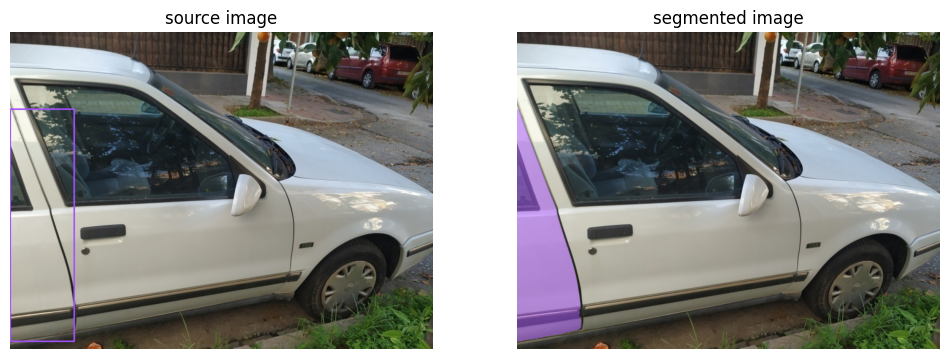

In [26]:
box_annotator = sv.BoxAnnotator(color_lookup=sv.ColorLookup.INDEX)
mask_annotator = sv.MaskAnnotator(color_lookup=sv.ColorLookup.INDEX)

detections = sv.Detections(
    xyxy=sv.mask_to_xyxy(masks=masks),
    mask=masks.astype(bool)
)

source_image = box_annotator.annotate(scene=image_bgr.copy(), detections=detections)
segmented_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

sv.plot_images_grid(
    images=[source_image, segmented_image],
    grid_size=(1, 2),
    titles=['source image', 'segmented image']
)

## Prompting with points

**NOTE:** Execute cell below and use your mouse to **draw points** on the image 👇

In [36]:
IS_COLAB = True

if IS_COLAB:
    from google.colab import output
    output.enable_custom_widget_manager()

from jupyter_bbox_widget import BBoxWidget

widget = BBoxWidget()
widget.image = encode_image(IMAGE_PATH)
widget

BBoxWidget(colors=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#b…

In [37]:
widget.bboxes

[{'x': 131, 'y': 490, 'width': 425, 'height': 390, 'label': ''}]

In [38]:
default_box = [
    {'x': 330, 'y': 450, 'width': 0, 'height': 0, 'label': ''},
    {'x': 191, 'y': 665, 'width': 0, 'height': 0, 'label': ''},
    {'x': 86, 'y': 879, 'width': 0, 'height': 0, 'label': ''},
    {'x': 425, 'y': 727, 'width': 0, 'height': 0, 'label': ''}
]

boxes = widget.bboxes if widget.bboxes else default_box
input_point = np.array([
    [
        box['x'],
        box['y']
    ] for box in boxes
])
input_label = np.ones(input_point.shape[0])

In [39]:
masks, scores, logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    multimask_output=True,
)

**NOTE:** With `multimask_output=True` (the default setting), SAM 2 outputs 3 masks, where scores gives the model's own estimation of the quality of these masks. This setting is intended for ambiguous input prompts, and helps the model disambiguate different objects consistent with the prompt. When False, it will return a single mask. For ambiguous prompts such as a single point, it is recommended to use `multimask_output=True` even if only a single mask is desired; the best single mask can be chosen by picking the one with the highest score returned in scores. This will often result in a better mask.

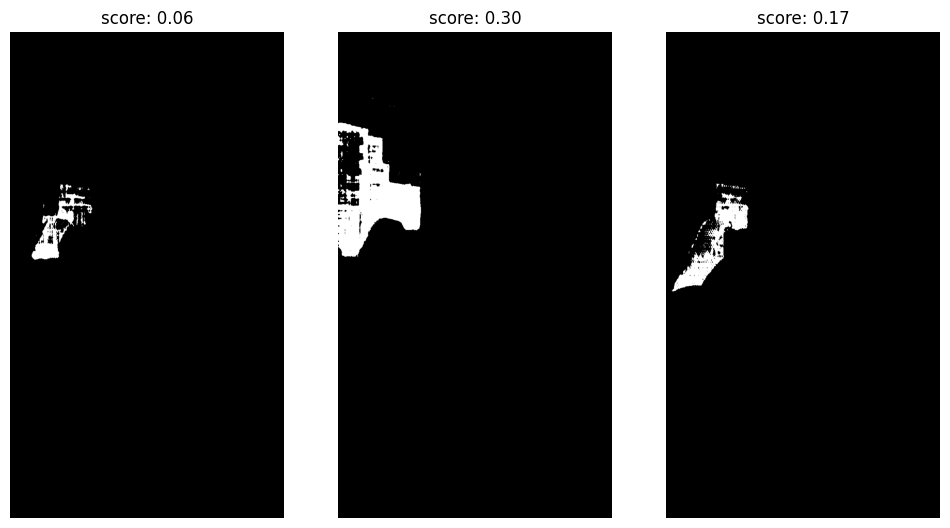

In [40]:
sv.plot_images_grid(
    images=masks,
    titles=[f"score: {score:.2f}" for score in scores],
    grid_size=(1, 3),
    size=(12, 12)
)

In [42]:
!unzip /content/train.zip

Archive:  /content/train.zip
   creating: train/
  inflating: train/extract_masks.py  
   creating: train/images/
  inflating: train/images/0_m_0.jpg  
  inflating: train/images/0_m_1.jpg  
  inflating: train/images/0_m_2.jpg  
  inflating: train/images/10_m_0.jpg  
  inflating: train/images/10_m_1.jpg  
  inflating: train/images/10_m_2.jpg  
  inflating: train/images/11_m_0.jpg  
  inflating: train/images/11_m_1.jpg  
  inflating: train/images/11_m_2.jpg  
  inflating: train/images/12_m_0.jpg  
  inflating: train/images/12_m_1.jpg  
  inflating: train/images/12_m_2.jpg  
  inflating: train/images/13_m_0.jpg  
  inflating: train/images/13_m_1.jpg  
  inflating: train/images/13_m_2.jpg  
  inflating: train/images/14_m_0.jpg  
  inflating: train/images/14_m_1.jpg  
  inflating: train/images/14_m_2.jpg  
  inflating: train/images/15_m_0.jpg  
  inflating: train/images/15_m_1.jpg  
  inflating: train/images/15_m_2.jpg  
  inflating: train/images/16_m_2.jpg  
  inflating: train/images/17_m_

img_name: 39_m_0.jpg
boxes: []
len masks: 0
img_name: 48_m_2.jpg
boxes: []
len masks: 0
img_name: 3_m_1.jpg
boxes: []
len masks: 0
img_name: 76_m_2.jpg
boxes: []
len masks: 0
img_name: 24_m_2.jpg
boxes: [[  1 262 132 510]]
box: [  1 262 132 510]
mask shape: (3, 720, 957)
len masks: 1


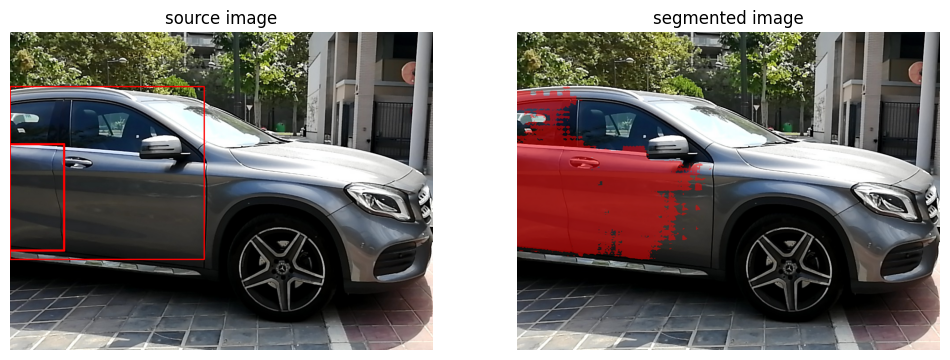

img_name: 55_m_2.jpg
boxes: []
len masks: 0
img_name: 7_m_1.jpg
boxes: [[750 389 828 208]]
box: [750 389 828 208]
mask shape: (3, 600, 800)
len masks: 1


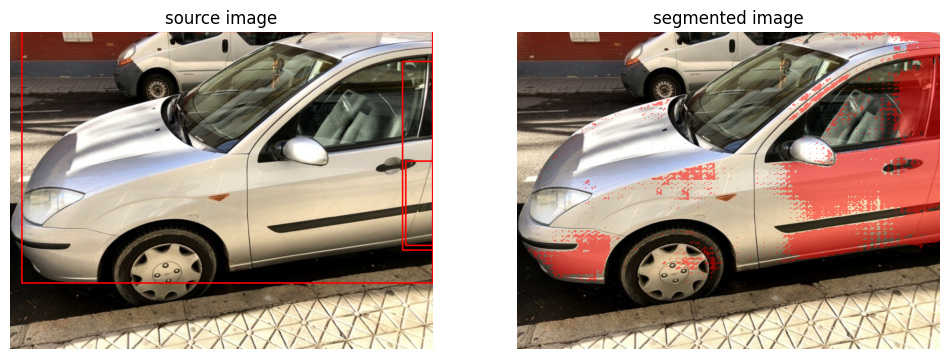

img_name: 34_m_2.jpg
boxes: [[  0 274  74 520]]
box: [  0 274  74 520]
mask shape: (3, 720, 957)
len masks: 1


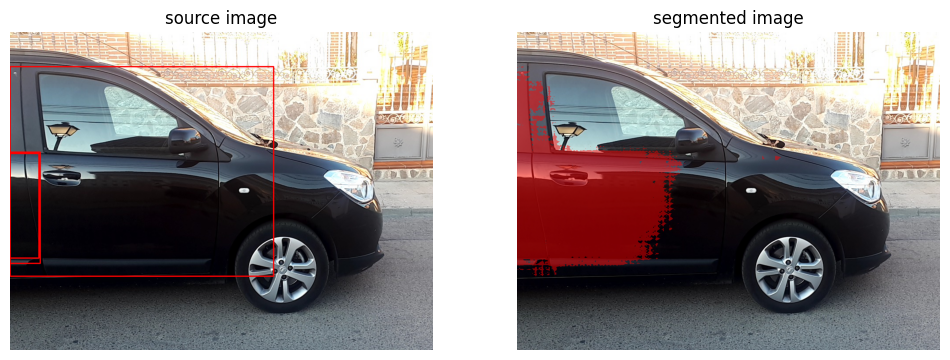

img_name: 50_m_2.jpg
boxes: []
len masks: 0
img_name: 8_m_1.jpg
boxes: []
len masks: 0
img_name: 99_m_2.jpg
boxes: []
len masks: 0
img_name: 70_m_2.jpg
boxes: []
len masks: 0
img_name: 32_m_2.jpg
boxes: []
len masks: 0
img_name: 42_m_0.jpg
boxes: [[ 62 534 -22 327]]
box: [ 62 534 -22 327]
mask shape: (3, 600, 800)
len masks: 1


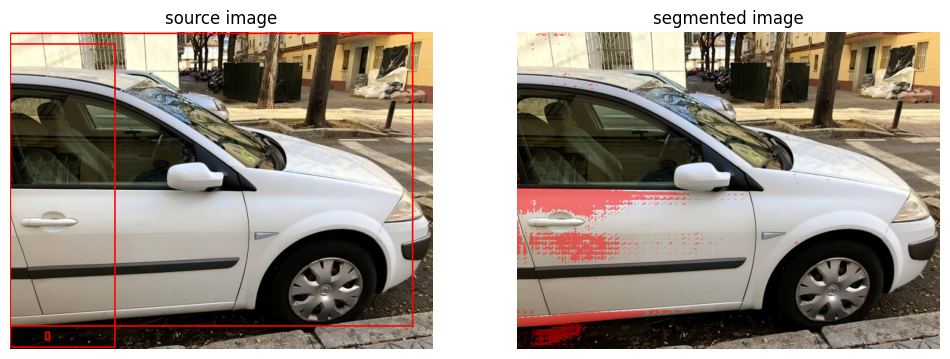

img_name: 31_m_2.jpg
boxes: []
len masks: 0
img_name: 51_m_0.jpg
boxes: []
len masks: 0
img_name: 11_m_1.jpg
boxes: [[799 460 759 325]]
box: [799 460 759 325]
mask shape: (3, 600, 800)
len masks: 1


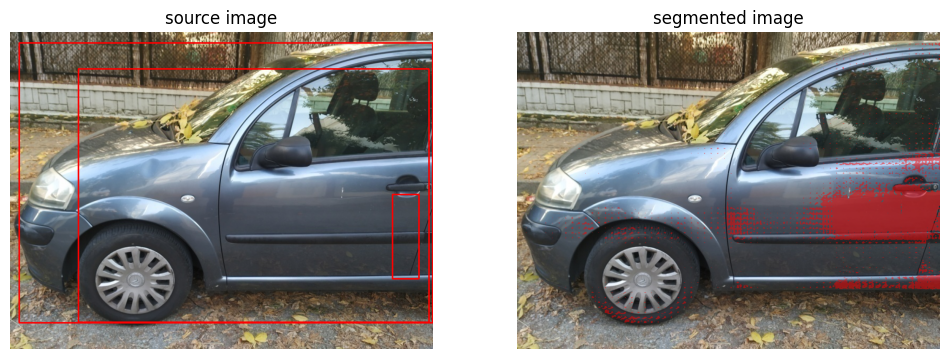

img_name: 97_m_2.jpg
boxes: [[  2 265  50 544]]
box: [  2 265  50 544]
mask shape: (3, 720, 957)
len masks: 1


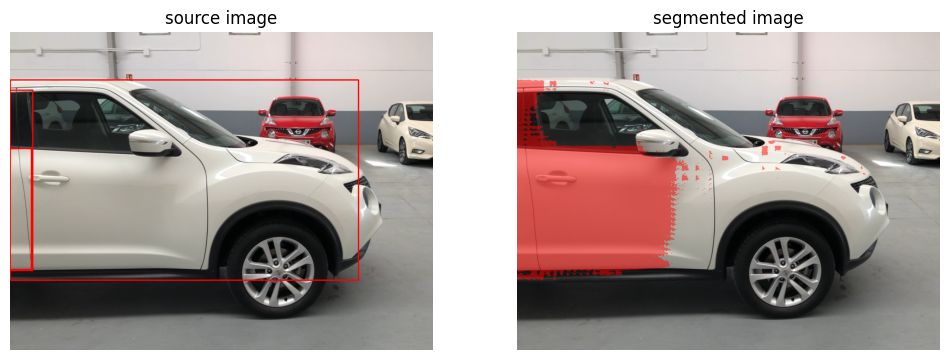

img_name: 39_m_1.jpg
boxes: [[719 471 835 268]
 [783  96 805 113]]
box: [719 471 835 268]
mask shape: (3, 600, 800)
box: [783  96 805 113]
mask shape: (3, 600, 800)
len masks: 2


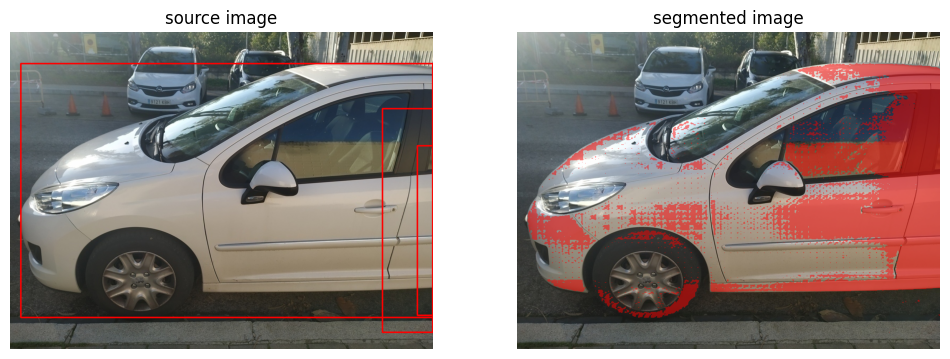

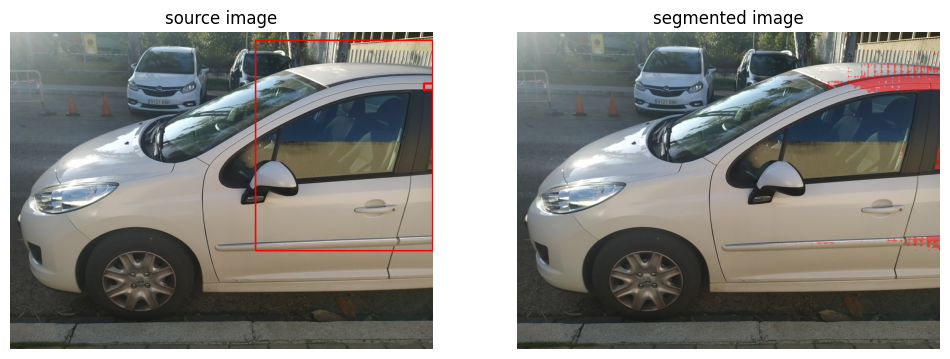

img_name: 19_m_2.jpg
boxes: []
len masks: 0
img_name: 22_m_2.jpg
boxes: []
len masks: 0
img_name: 13_m_2.jpg
boxes: []
len masks: 0
img_name: 8_m_0.jpg
boxes: [[ 31 397 -26 270]]
box: [ 31 397 -26 270]
mask shape: (3, 600, 800)
len masks: 1


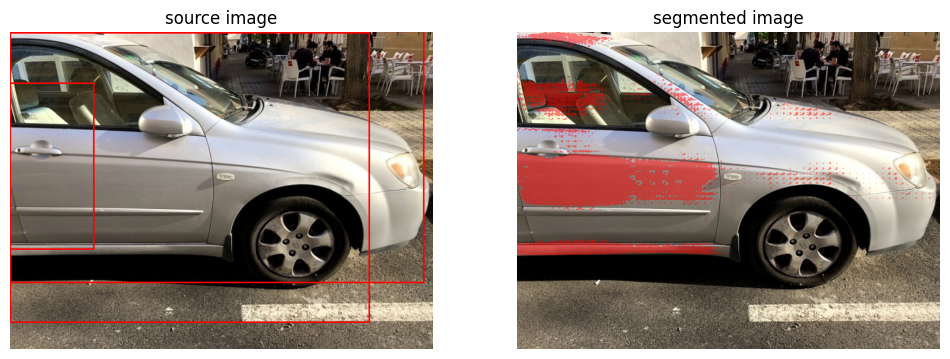

img_name: 11_m_0.jpg
boxes: [[  1 259  54 490]]
box: [  1 259  54 490]
mask shape: (3, 600, 800)
len masks: 1


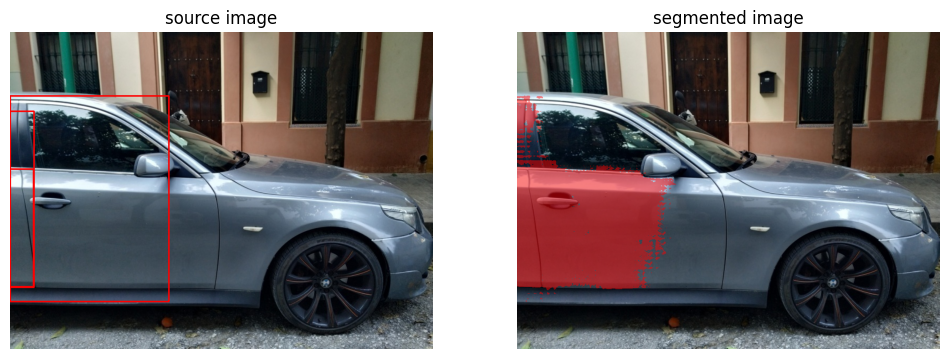

img_name: 63_m_2.jpg
boxes: []
len masks: 0
img_name: 24_m_0.jpg
boxes: [[111 491 -18 201]]
box: [111 491 -18 201]
mask shape: (3, 600, 800)
len masks: 1


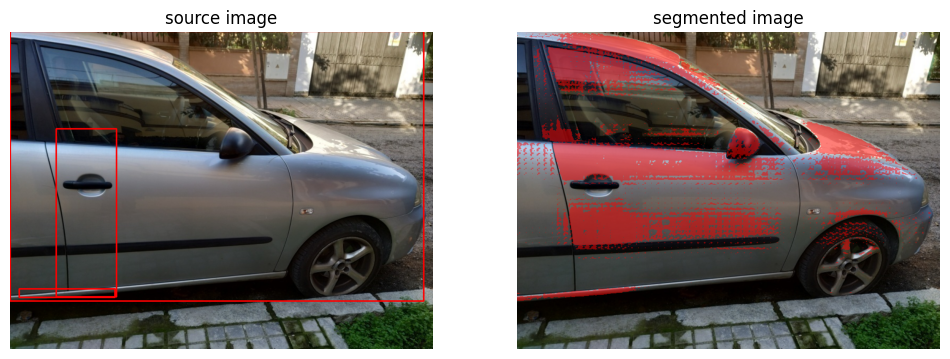

img_name: 50_m_0.jpg
boxes: []
len masks: 0
img_name: 32_m_0.jpg
boxes: [[ 36 455 -15 274]]
box: [ 36 455 -15 274]
mask shape: (3, 600, 800)
len masks: 1


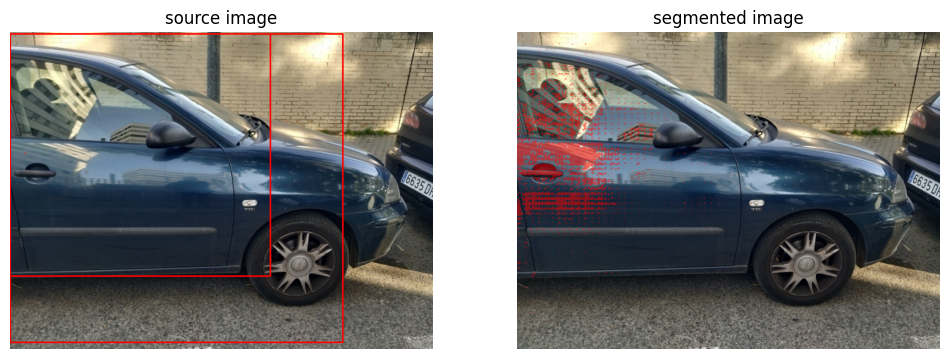

img_name: 31_m_1.jpg
boxes: [[712 491 825 281]]
box: [712 491 825 281]
mask shape: (3, 600, 800)
len masks: 1


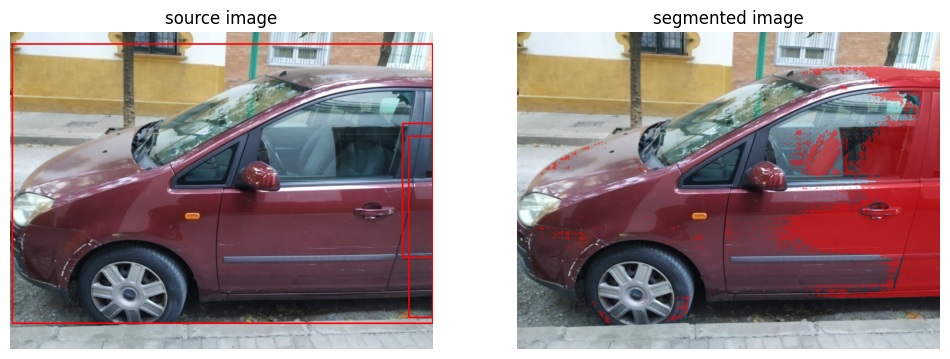

img_name: 27_m_0.jpg
boxes: [[  1 244 120 465]]
box: [  1 244 120 465]
mask shape: (3, 600, 800)
len masks: 1


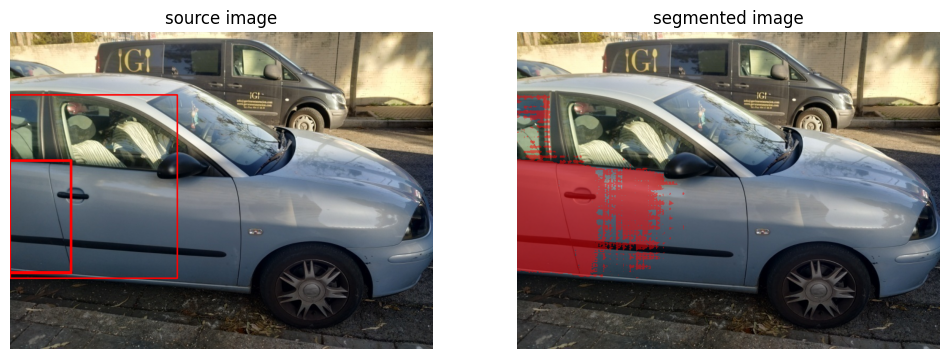

img_name: 29_m_1.jpg
boxes: []
len masks: 0
img_name: 51_m_2.jpg
boxes: []
len masks: 0
img_name: 84_m_2.jpg
boxes: []
len masks: 0
img_name: 5_m_0.jpg
boxes: [[  0 311  48 492]]
box: [  0 311  48 492]
mask shape: (3, 600, 800)
len masks: 1


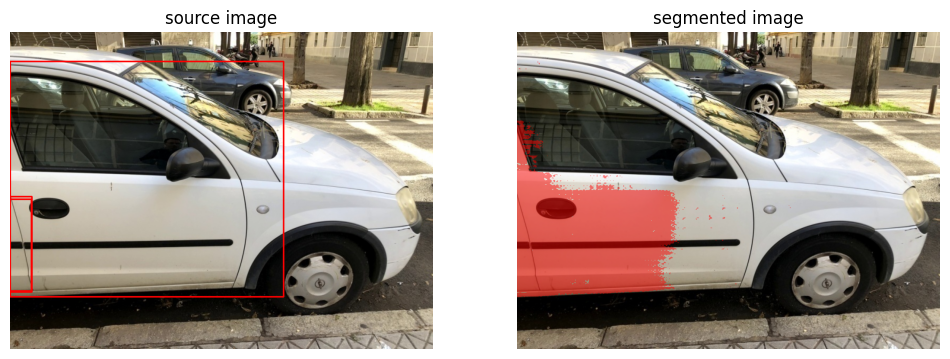

img_name: 2_m_0.jpg
boxes: [[  1 292  88 509]]
box: [  1 292  88 509]
mask shape: (3, 600, 800)
len masks: 1


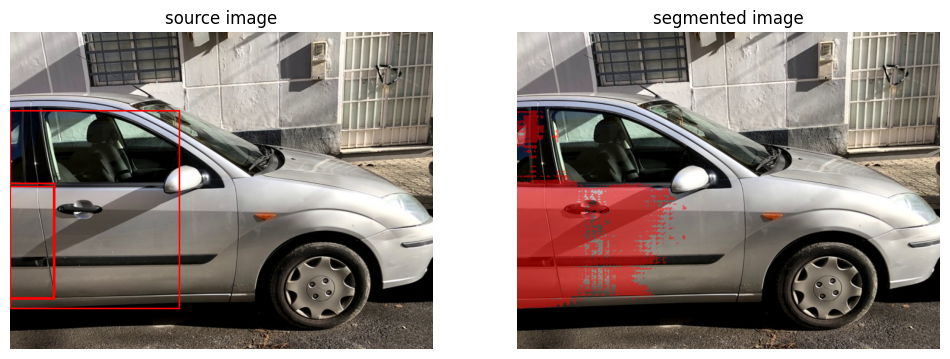

img_name: 25_m_2.jpg
boxes: []
len masks: 0
img_name: 7_m_2.jpg
boxes: [[ 18 477 -15 359]]
box: [ 18 477 -15 359]
mask shape: (3, 720, 957)
len masks: 1


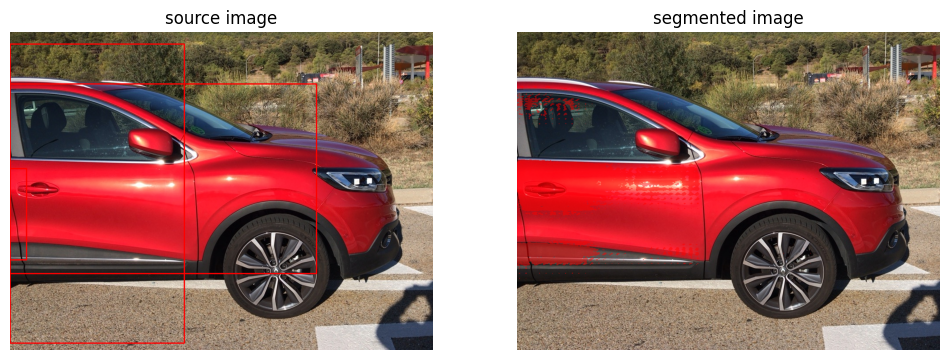

img_name: 61_m_2.jpg
boxes: []
len masks: 0
img_name: 6_m_0.jpg
boxes: []
len masks: 0
img_name: 12_m_0.jpg
boxes: []
len masks: 0
img_name: 17_m_0.jpg
boxes: [[  1 265   2 268]]
box: [  1 265   2 268]
mask shape: (3, 600, 800)
len masks: 1


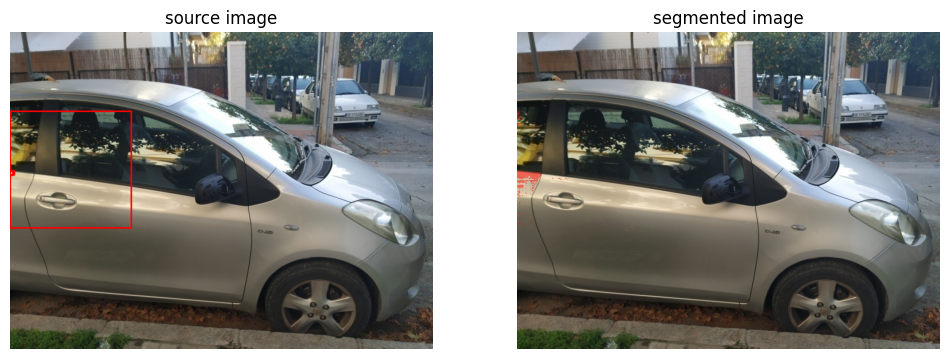

img_name: 26_m_1.jpg
boxes: [[729 478 822 149]]
box: [729 478 822 149]
mask shape: (3, 600, 800)
len masks: 1


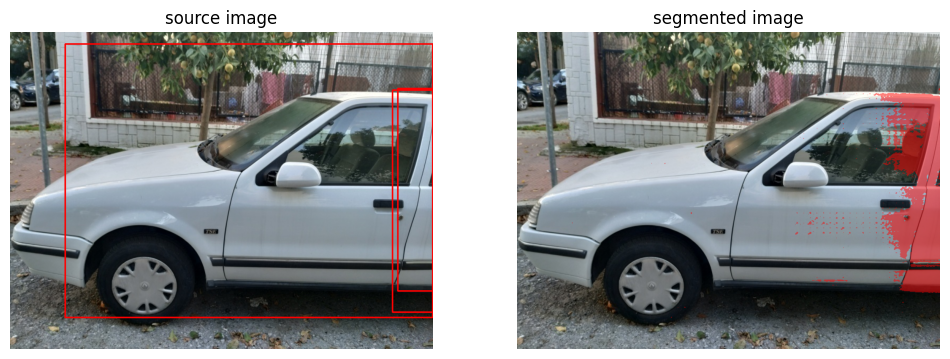

img_name: 94_m_2.jpg
boxes: [[  1 306 115 543]]
box: [  1 306 115 543]
mask shape: (3, 720, 957)
len masks: 1


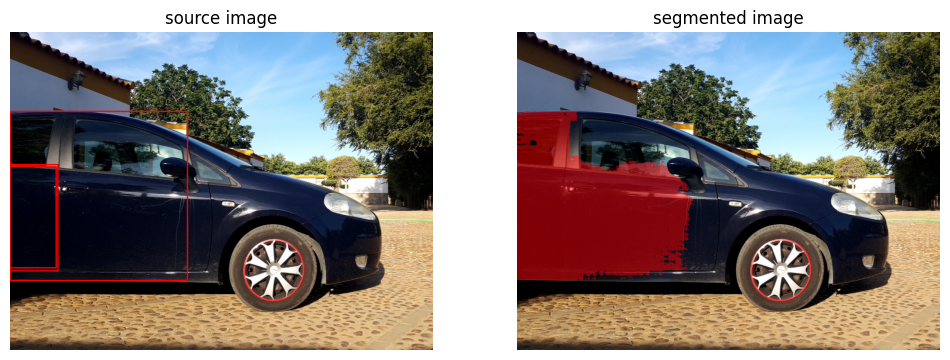

img_name: 88_m_2.jpg
boxes: [[  0 262  36 545]]
box: [  0 262  36 545]
mask shape: (3, 720, 957)
len masks: 1


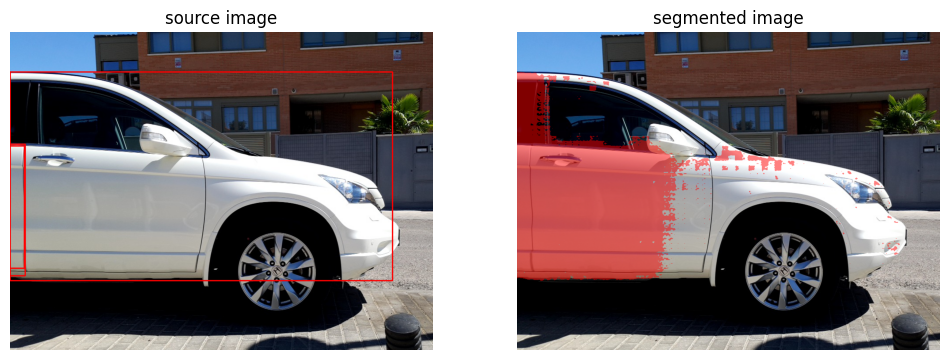

img_name: 41_m_0.jpg
boxes: []
len masks: 0
img_name: 31_m_0.jpg
boxes: [[  1 248  66 479]]
box: [  1 248  66 479]
mask shape: (3, 600, 800)
len masks: 1


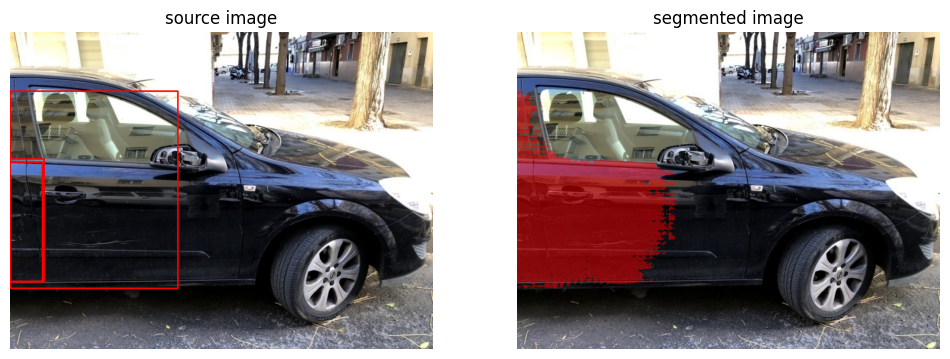

img_name: 34_m_0.jpg
boxes: [[  0 318  55 536]]
box: [  0 318  55 536]
mask shape: (3, 600, 800)
len masks: 1


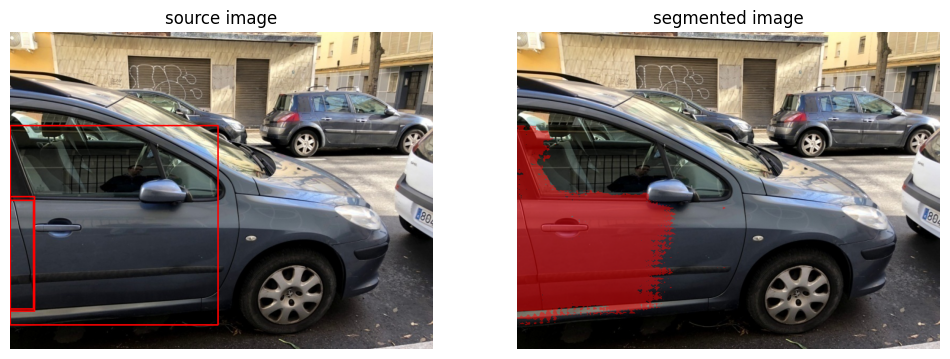

img_name: 38_m_2.jpg
boxes: []
len masks: 0
img_name: 92_m_2.jpg
boxes: []
len masks: 0
img_name: 52_m_1.jpg
boxes: [[710 101 803 114]
 [711 115 734 251]
 [709 254 801 456]
 [679 454 820 255]]
box: [710 101 803 114]
mask shape: (3, 600, 800)
box: [711 115 734 251]
mask shape: (3, 600, 800)
box: [709 254 801 456]
mask shape: (3, 600, 800)
box: [679 454 820 255]
mask shape: (3, 600, 800)
len masks: 4


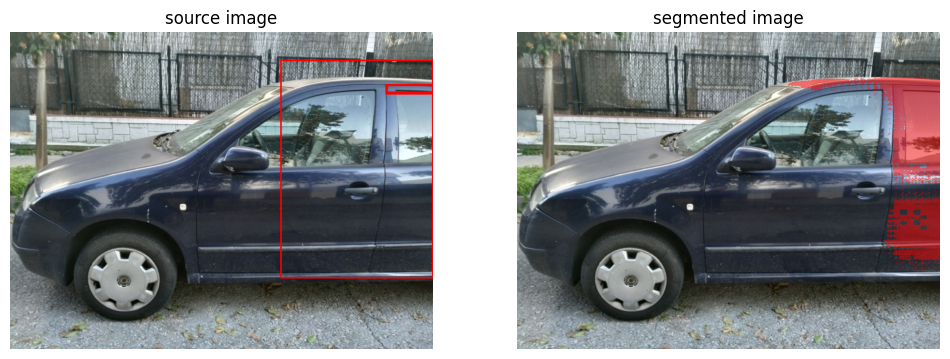

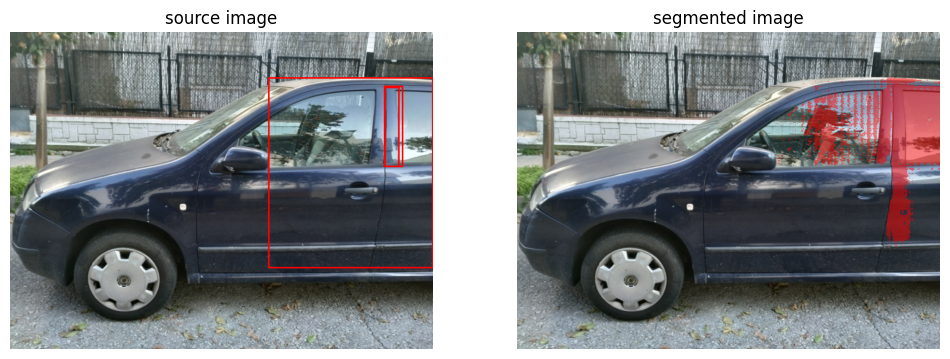

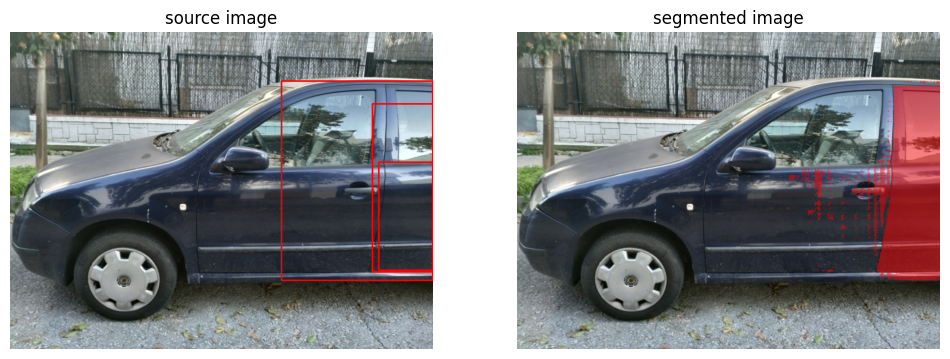

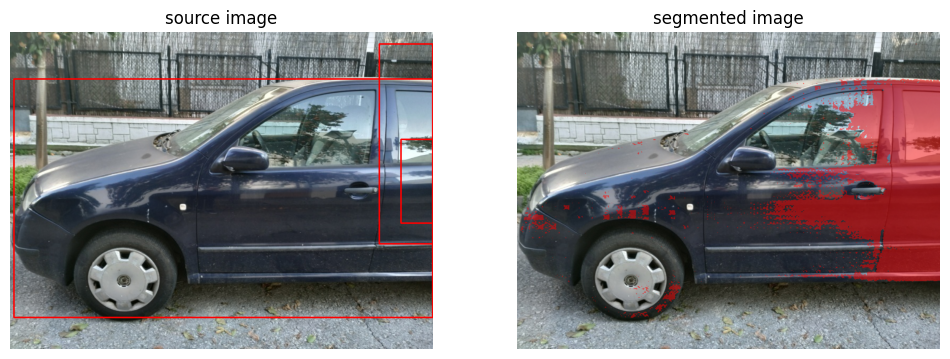

img_name: 14_m_1.jpg
boxes: [[772 566 809 455]]
box: [772 566 809 455]
mask shape: (3, 600, 800)
len masks: 1


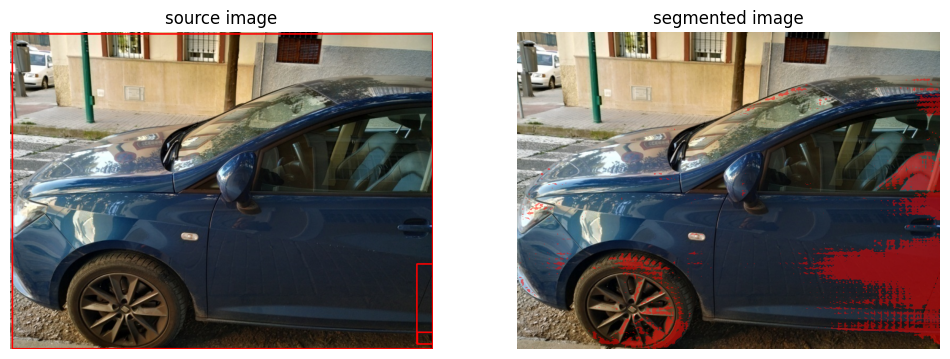

img_name: 23_m_0.jpg
boxes: [[135 528 -38  88]]
box: [135 528 -38  88]
mask shape: (3, 600, 800)
len masks: 1


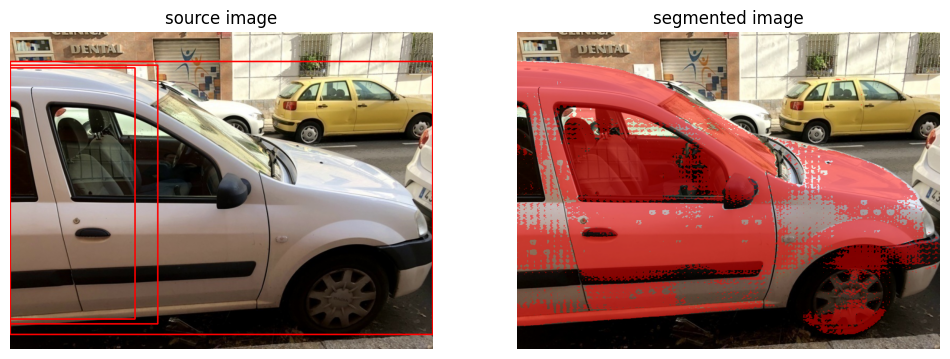

img_name: 0_m_0.jpg
boxes: [[  2 266 130 521]
 [  1  41  59  57]]
box: [  2 266 130 521]
mask shape: (3, 600, 800)
box: [ 1 41 59 57]
mask shape: (3, 600, 800)
len masks: 2


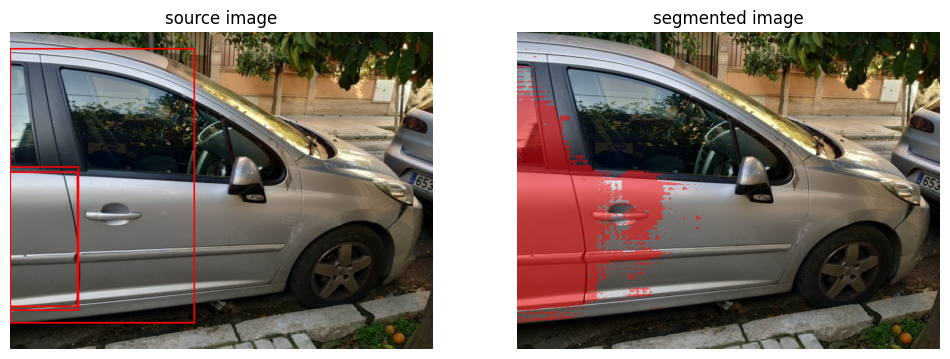

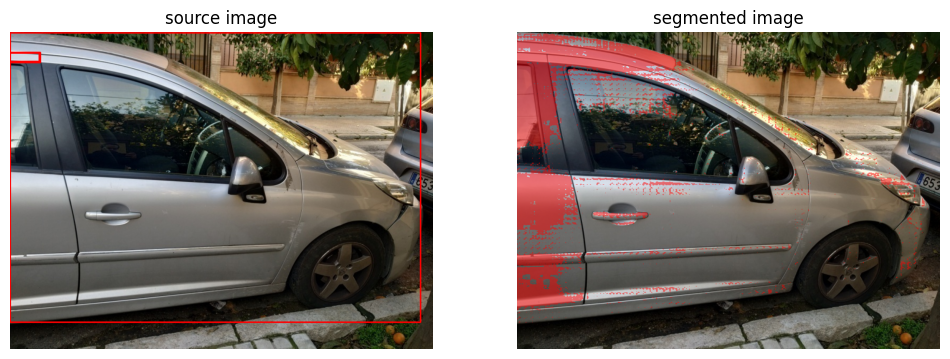

img_name: 41_m_2.jpg
boxes: []
len masks: 0
img_name: 11_m_2.jpg
boxes: []
len masks: 0
img_name: 44_m_0.jpg
boxes: [[ 64 498 -18 259]]
box: [ 64 498 -18 259]
mask shape: (3, 600, 800)
len masks: 1


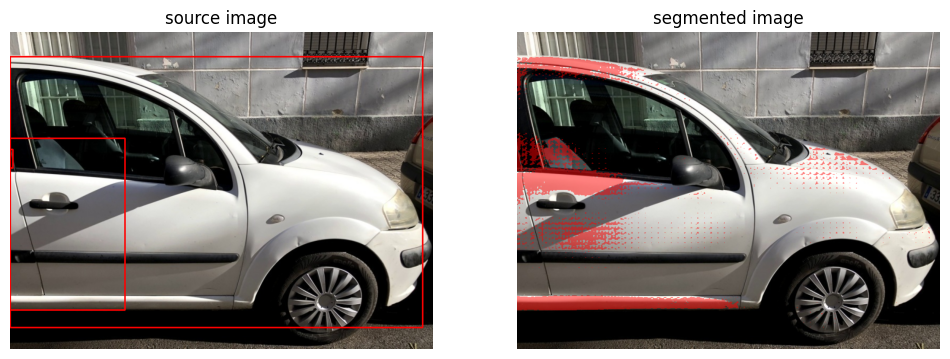

img_name: 78_m_2.jpg
boxes: []
len masks: 0
img_name: 4_m_0.jpg
boxes: [[125 564 -30 125]]
box: [125 564 -30 125]
mask shape: (3, 600, 800)
len masks: 1


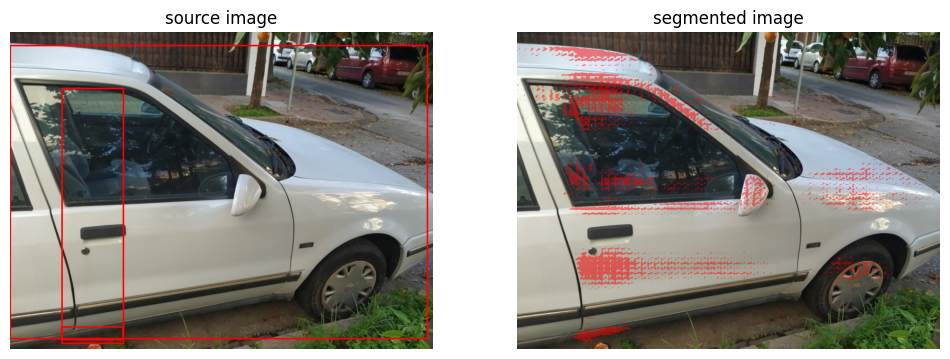

img_name: 38_m_1.jpg
boxes: []
len masks: 0
img_name: 21_m_1.jpg
boxes: [[752 472 819 222]]
box: [752 472 819 222]
mask shape: (3, 600, 800)
len masks: 1


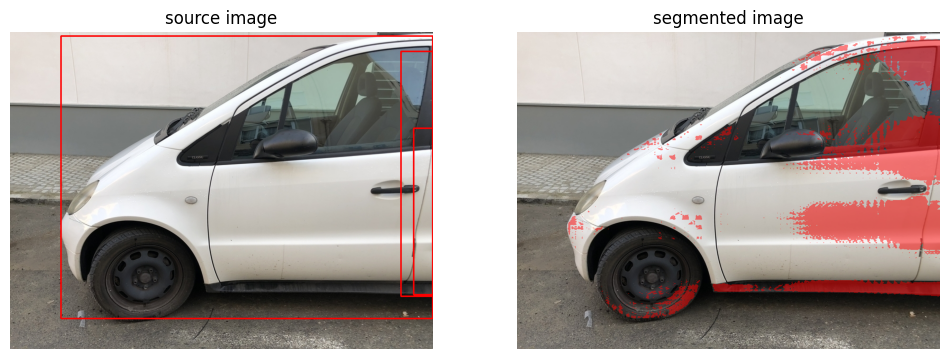

img_name: 79_m_2.jpg
boxes: []
len masks: 0
img_name: 36_m_1.jpg
boxes: [[764 440 832 299]]
box: [764 440 832 299]
mask shape: (3, 600, 800)
len masks: 1


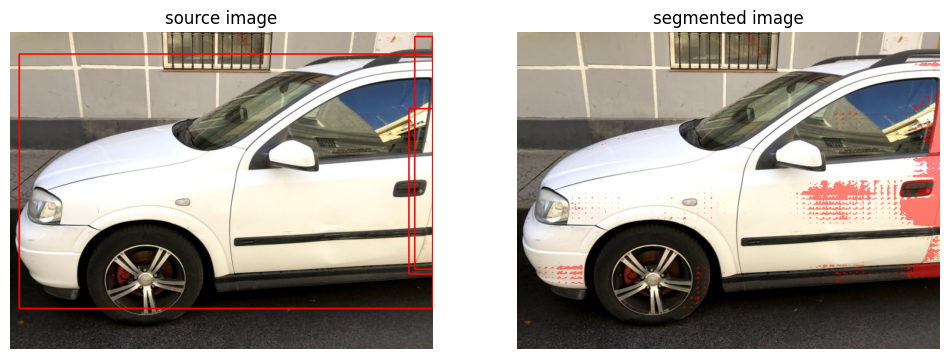

img_name: 46_m_1.jpg
boxes: [[745 464 817 223]]
box: [745 464 817 223]
mask shape: (3, 600, 800)
len masks: 1


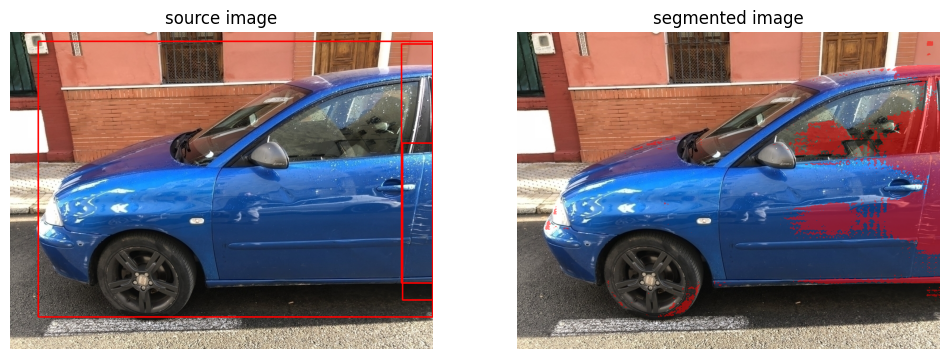

img_name: 45_m_1.jpg
boxes: [[736 472 851 287]]
box: [736 472 851 287]
mask shape: (3, 600, 800)
len masks: 1


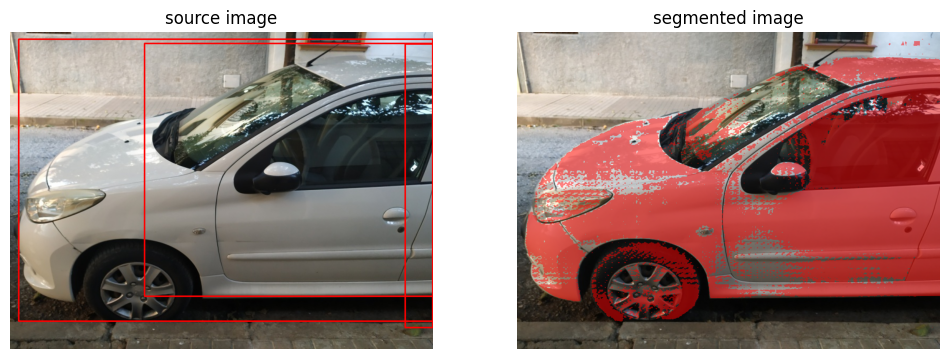

img_name: 54_m_2.jpg
boxes: [[  0 277 105 530]]
box: [  0 277 105 530]
mask shape: (3, 720, 957)
len masks: 1


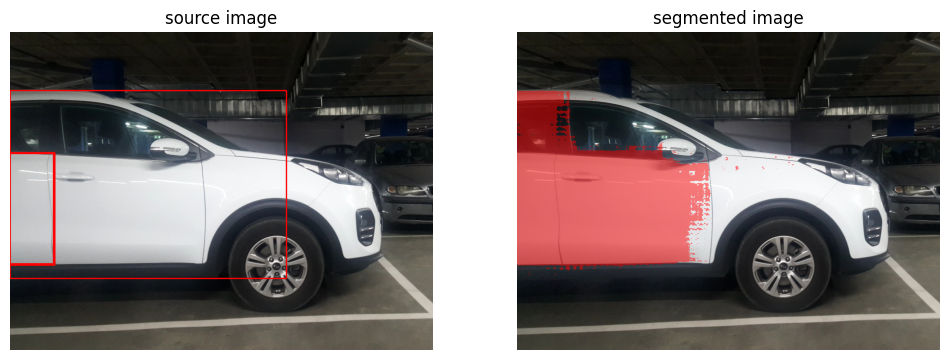

img_name: 89_m_2.jpg
boxes: []
len masks: 0
img_name: 90_m_2.jpg
boxes: [[  0 300  52 575]]
box: [  0 300  52 575]
mask shape: (3, 720, 957)
len masks: 1


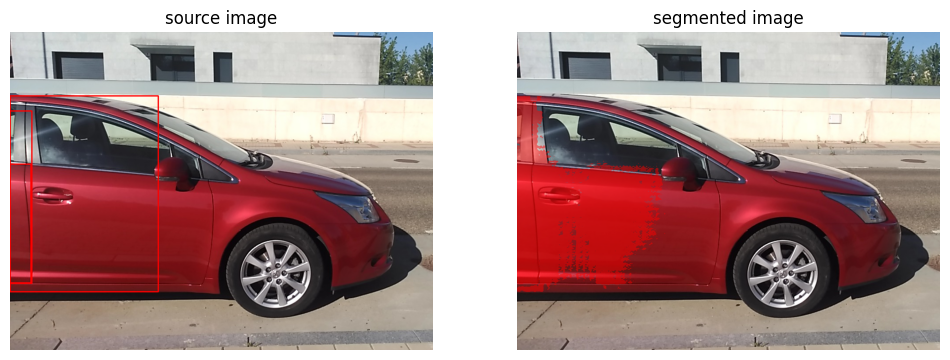

img_name: 40_m_1.jpg
boxes: []
len masks: 0
img_name: 28_m_2.jpg
boxes: []
len masks: 0
img_name: 60_m_2.jpg
boxes: []
len masks: 0
img_name: 40_m_0.jpg
boxes: []
len masks: 0
img_name: 1_m_1.jpg
boxes: [[744 426 807 242]]
box: [744 426 807 242]
mask shape: (3, 600, 800)
len masks: 1


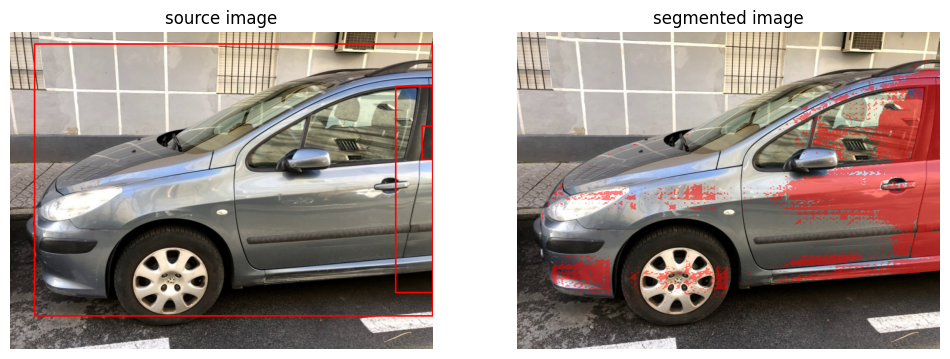

img_name: 36_m_2.jpg
boxes: [[  0 116  97 551]]
box: [  0 116  97 551]
mask shape: (3, 720, 957)
len masks: 1


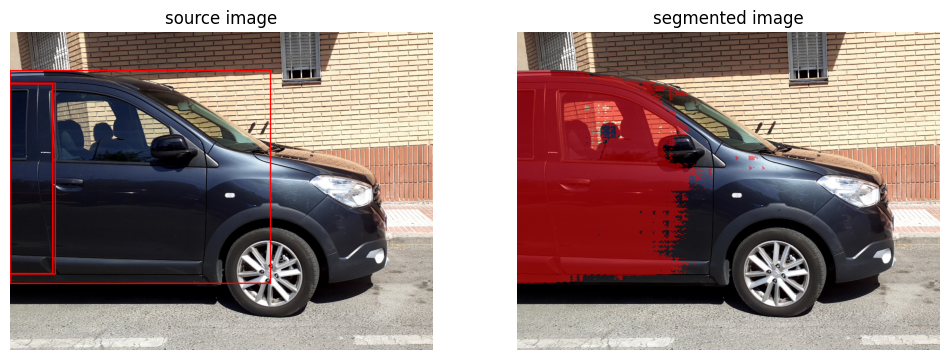

img_name: 29_m_2.jpg
boxes: []
len masks: 0
img_name: 14_m_2.jpg
boxes: []
len masks: 0
img_name: 37_m_2.jpg
boxes: []
len masks: 0
img_name: 12_m_2.jpg
boxes: []
len masks: 0
img_name: 1_m_0.jpg
boxes: [[  0 303  64 462]]
box: [  0 303  64 462]
mask shape: (3, 600, 800)
len masks: 1


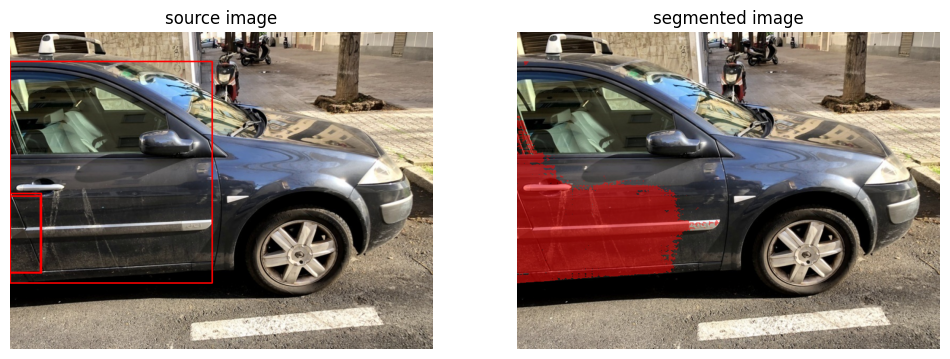

img_name: 18_m_2.jpg
boxes: []
len masks: 0
img_name: 0_m_2.jpg
boxes: []
len masks: 0
img_name: 2_m_1.jpg
boxes: [[748 437 824 148]]
box: [748 437 824 148]
mask shape: (3, 600, 800)
len masks: 1


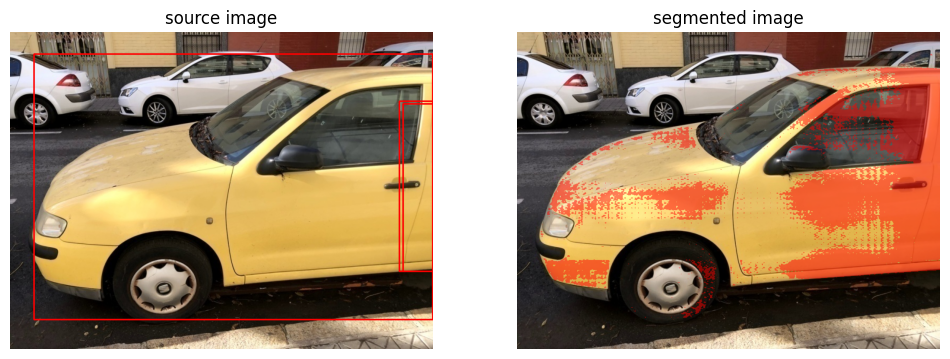

img_name: 59_m_2.jpg
boxes: []
len masks: 0
img_name: 18_m_0.jpg
boxes: []
len masks: 0
img_name: 1_m_2.jpg
boxes: []
len masks: 0
img_name: 20_m_1.jpg
boxes: []
len masks: 0
img_name: 49_m_1.jpg
boxes: [[737 461 821 183]]
box: [737 461 821 183]
mask shape: (3, 600, 800)
len masks: 1


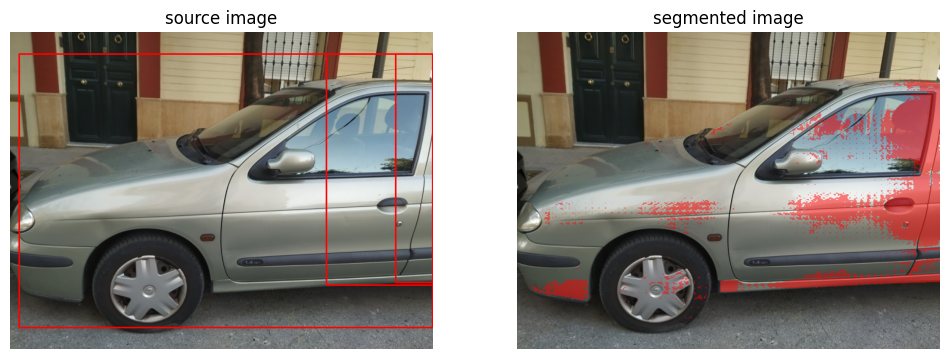

img_name: 40_m_2.jpg
boxes: []
len masks: 0
img_name: 87_m_2.jpg
boxes: []
len masks: 0
img_name: 16_m_2.jpg
boxes: []
len masks: 0
img_name: 86_m_2.jpg
boxes: []
len masks: 0
img_name: 75_m_2.jpg
boxes: []
len masks: 0
img_name: 6_m_2.jpg
boxes: []
len masks: 0
img_name: 35_m_2.jpg
boxes: [[  0 314  85 560]]
box: [  0 314  85 560]
mask shape: (3, 720, 957)
len masks: 1


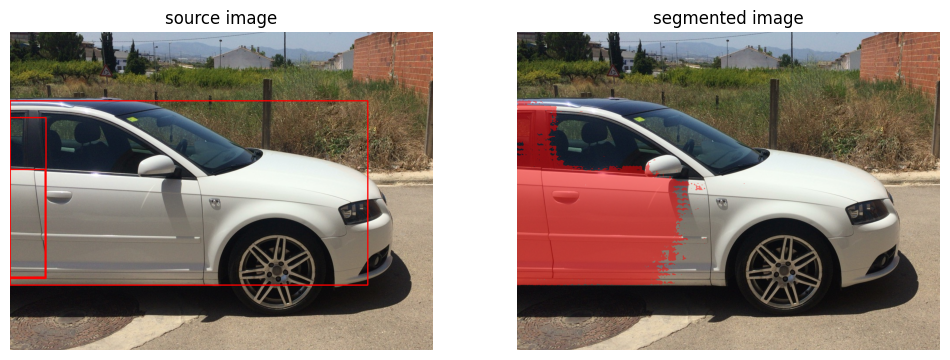

img_name: 42_m_2.jpg
boxes: []
len masks: 0
img_name: 69_m_2.jpg
boxes: []
len masks: 0
img_name: 46_m_0.jpg
boxes: []
len masks: 0
img_name: 98_m_2.jpg
boxes: []
len masks: 0
img_name: 85_m_2.jpg
boxes: []
len masks: 0
img_name: 34_m_1.jpg
boxes: []
len masks: 0
img_name: 58_m_2.jpg
boxes: []
len masks: 0
img_name: 49_m_2.jpg
boxes: []
len masks: 0
img_name: 83_m_2.jpg
boxes: []
len masks: 0
img_name: 21_m_0.jpg
boxes: []
len masks: 0
img_name: 39_m_2.jpg
boxes: []
len masks: 0
img_name: 2_m_2.jpg
boxes: []
len masks: 0
img_name: 32_m_1.jpg
boxes: []
len masks: 0
img_name: 66_m_2.jpg
boxes: []
len masks: 0
img_name: 29_m_0.jpg
boxes: []
len masks: 0
img_name: 19_m_1.jpg
boxes: [[771 481 821 344]]
box: [771 481 821 344]
mask shape: (3, 600, 800)
len masks: 1


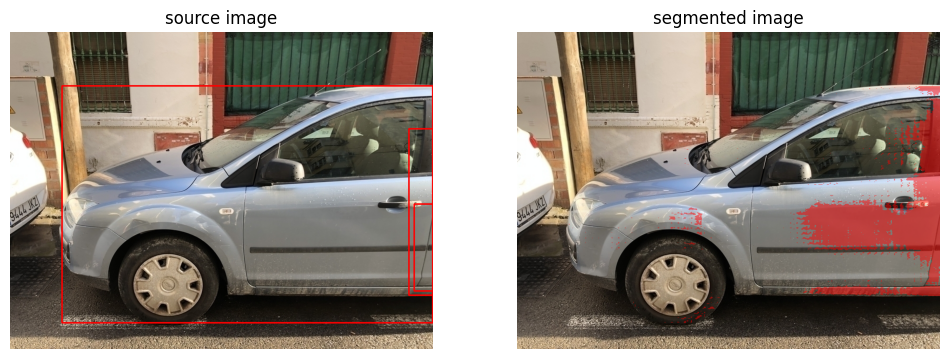

img_name: 9_m_0.jpg
boxes: [[ 71 531 -21 236]]
box: [ 71 531 -21 236]
mask shape: (3, 600, 800)
len masks: 1


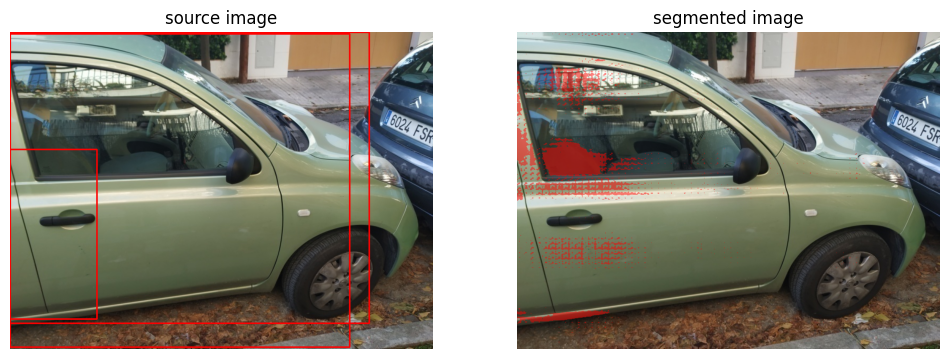

img_name: 7_m_0.jpg
boxes: []
len masks: 0
img_name: 4_m_2.jpg
boxes: []
len masks: 0
img_name: 64_m_2.jpg
boxes: []
len masks: 0
img_name: 24_m_1.jpg
boxes: [[798 546 756 361]]
box: [798 546 756 361]
mask shape: (3, 600, 800)
len masks: 1


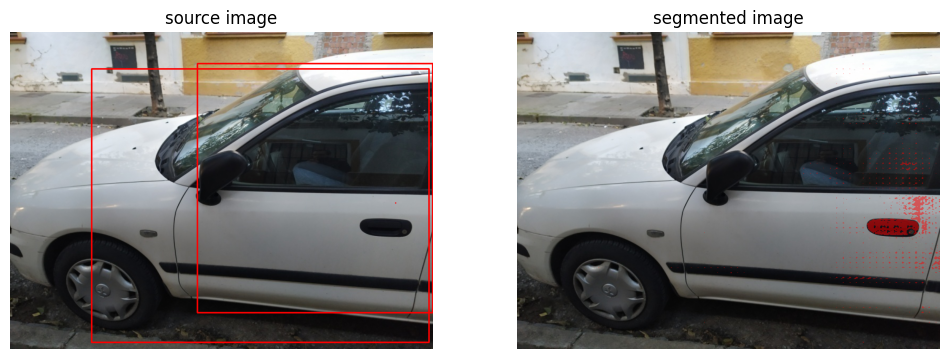

img_name: 3_m_2.jpg
boxes: []
len masks: 0
img_name: 30_m_2.jpg
boxes: [[  1 341 169 572]]
box: [  1 341 169 572]
mask shape: (3, 720, 957)
len masks: 1


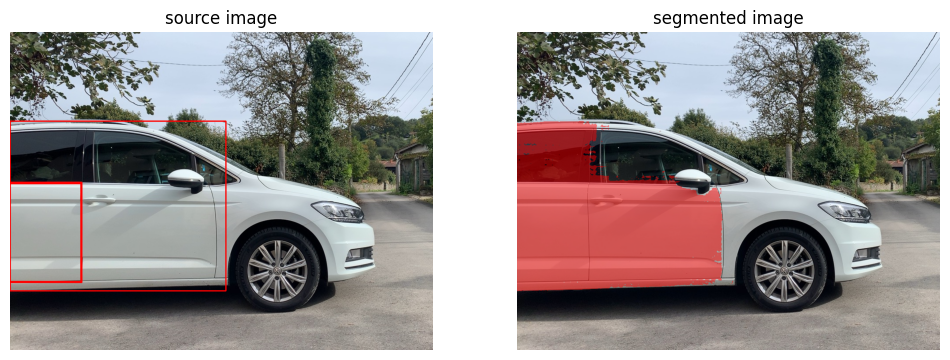

img_name: 43_m_2.jpg
boxes: [[  2 218  43 485]
 [  4  64  47  78]]
box: [  2 218  43 485]
mask shape: (3, 720, 957)
box: [ 4 64 47 78]
mask shape: (3, 720, 957)
len masks: 2


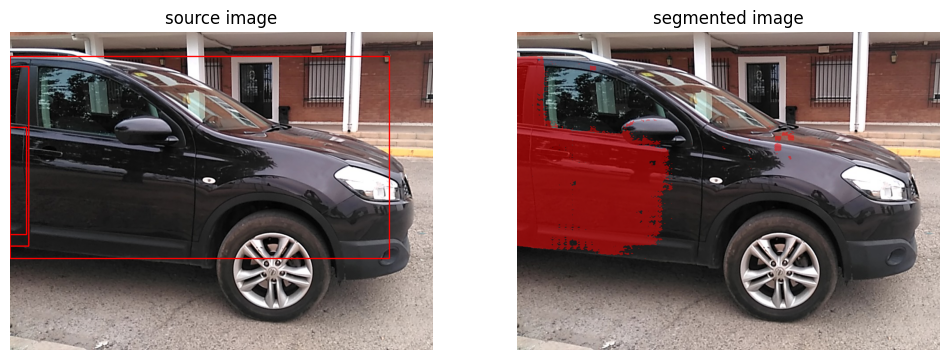

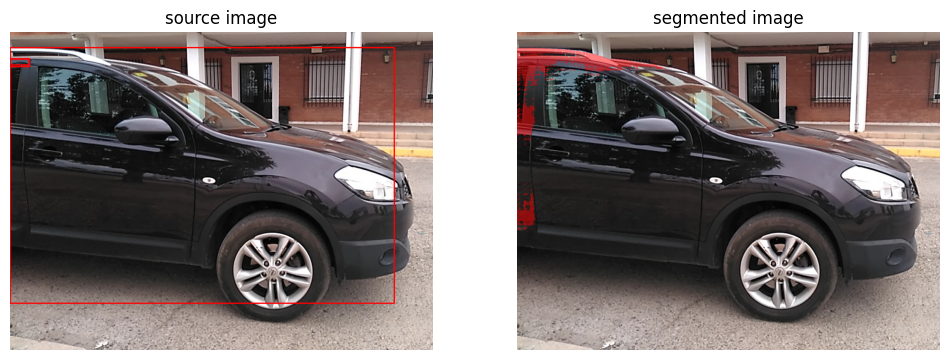

img_name: 37_m_1.jpg
boxes: [[713  45 830 406]]
box: [713  45 830 406]
mask shape: (3, 600, 800)
len masks: 1


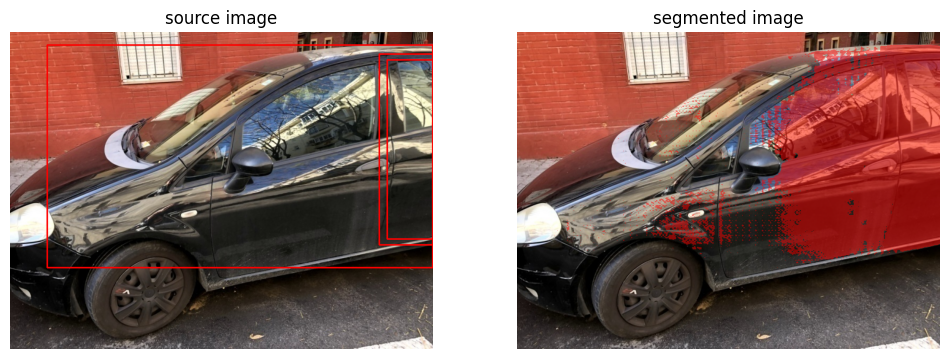

img_name: 71_m_2.jpg
boxes: []
len masks: 0
img_name: 46_m_2.jpg
boxes: []
len masks: 0
img_name: 17_m_1.jpg
boxes: []
len masks: 0
img_name: 9_m_1.jpg
boxes: []
len masks: 0
img_name: 53_m_1.jpg
boxes: [[756 473 823 265]]
box: [756 473 823 265]
mask shape: (3, 600, 800)
len masks: 1


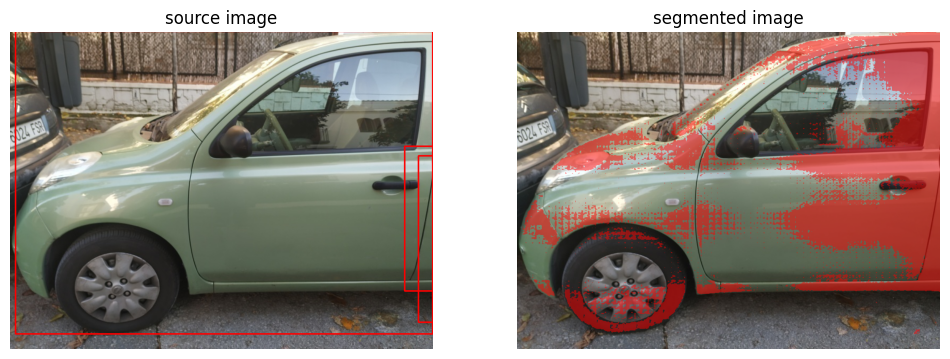

img_name: 22_m_1.jpg
boxes: []
len masks: 0
img_name: 12_m_1.jpg
boxes: [[799 433 748 243]]
box: [799 433 748 243]
mask shape: (3, 600, 800)
len masks: 1


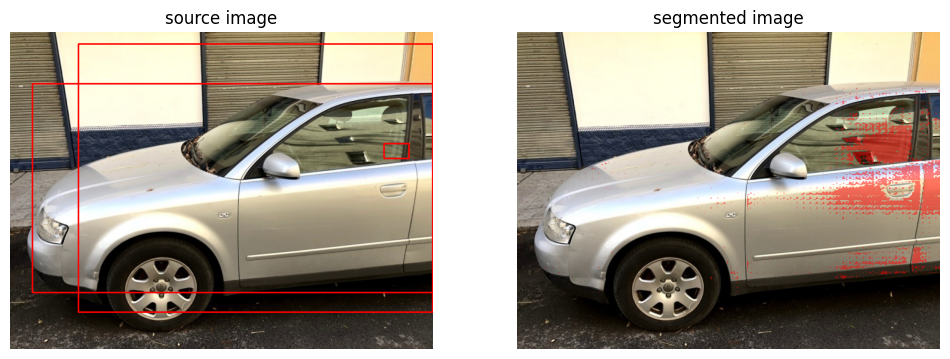

img_name: 53_m_2.jpg
boxes: []
len masks: 0
img_name: 27_m_2.jpg
boxes: [[  1 322  97 527]]
box: [  1 322  97 527]
mask shape: (3, 720, 957)
len masks: 1


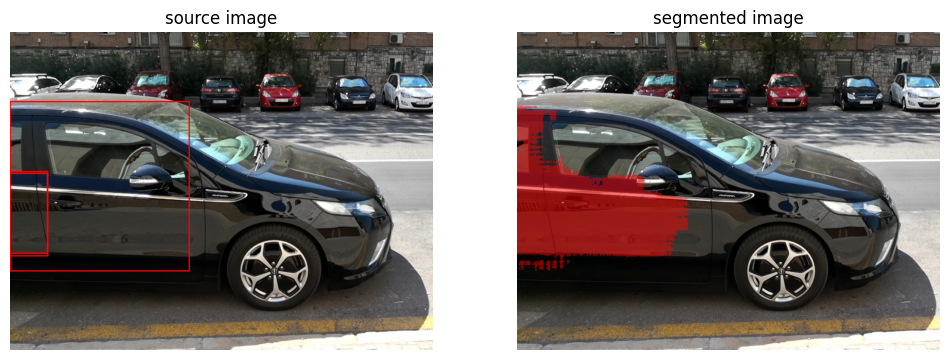

img_name: 45_m_0.jpg
boxes: [[138 569 -15 296]]
box: [138 569 -15 296]
mask shape: (3, 600, 800)
len masks: 1


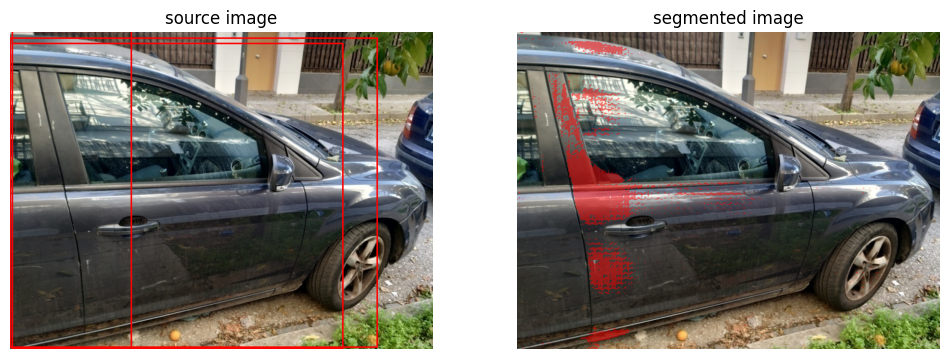

img_name: 62_m_2.jpg
boxes: []
len masks: 0
img_name: 93_m_2.jpg
boxes: []
len masks: 0
img_name: 14_m_0.jpg
boxes: [[  1 195  61 432]]
box: [  1 195  61 432]
mask shape: (3, 600, 800)
len masks: 1


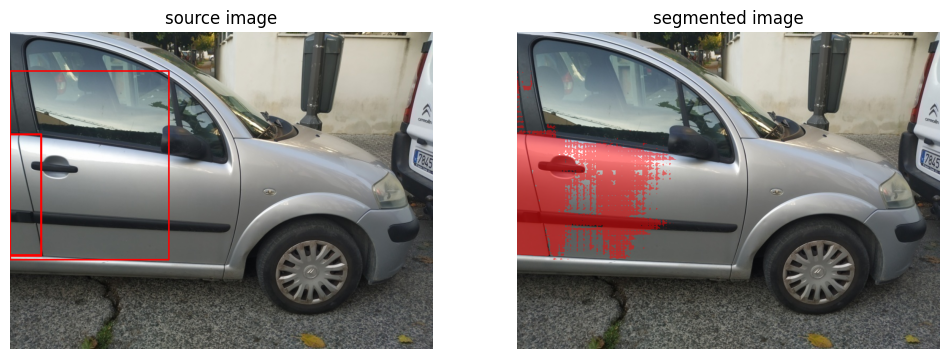

img_name: 18_m_1.jpg
boxes: []
len masks: 0
img_name: 20_m_2.jpg
boxes: []
len masks: 0
img_name: 0_m_1.jpg
boxes: [[799 431 711 241]]
box: [799 431 711 241]
mask shape: (3, 600, 800)
len masks: 1


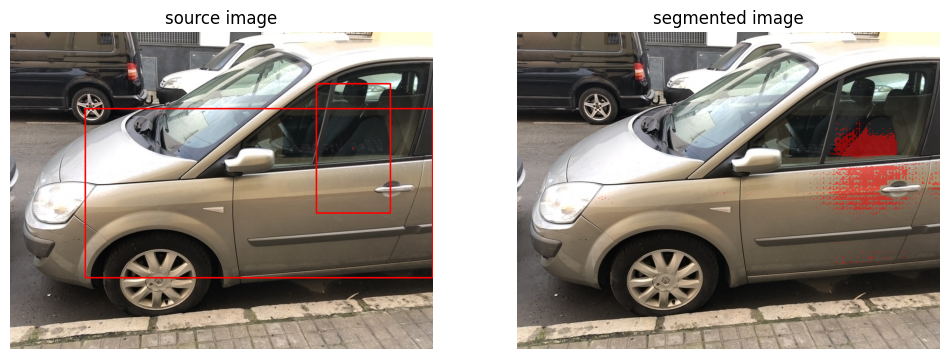

img_name: 4_m_1.jpg
boxes: [[773 502 835 352]]
box: [773 502 835 352]
mask shape: (3, 600, 800)
len masks: 1


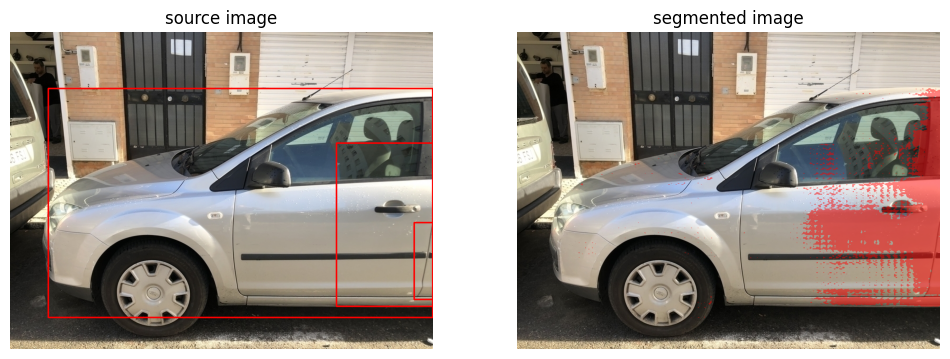

img_name: 5_m_1.jpg
boxes: []
len masks: 0
img_name: 35_m_0.jpg
boxes: [[  1 345 205 603]]
box: [  1 345 205 603]
mask shape: (3, 600, 800)
len masks: 1


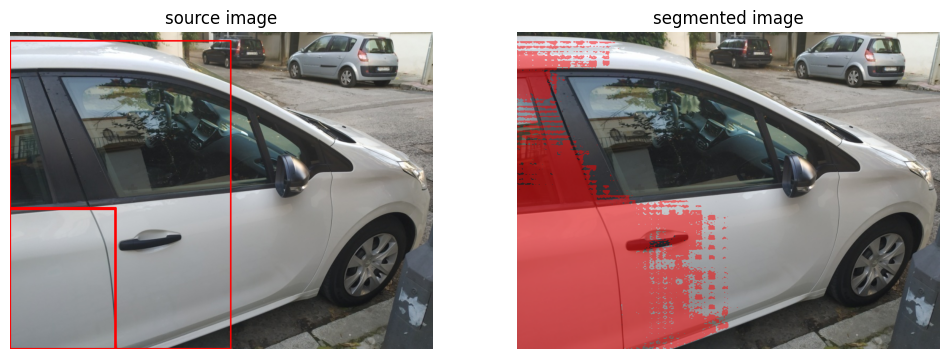

img_name: 17_m_2.jpg
boxes: []
len masks: 0
img_name: 42_m_1.jpg
boxes: [[733 462 816 239]
 [772  64 808  84]]
box: [733 462 816 239]
mask shape: (3, 600, 800)
box: [772  64 808  84]
mask shape: (3, 600, 800)
len masks: 2


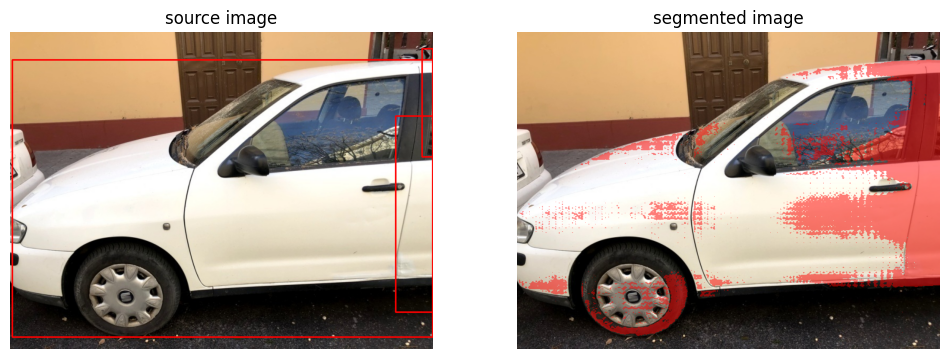

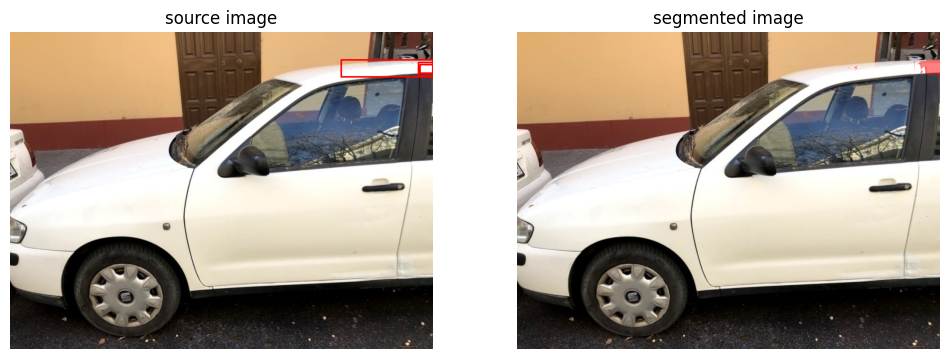

img_name: 13_m_0.jpg
boxes: [[  0 196  84 440]]
box: [  0 196  84 440]
mask shape: (3, 600, 800)
len masks: 1


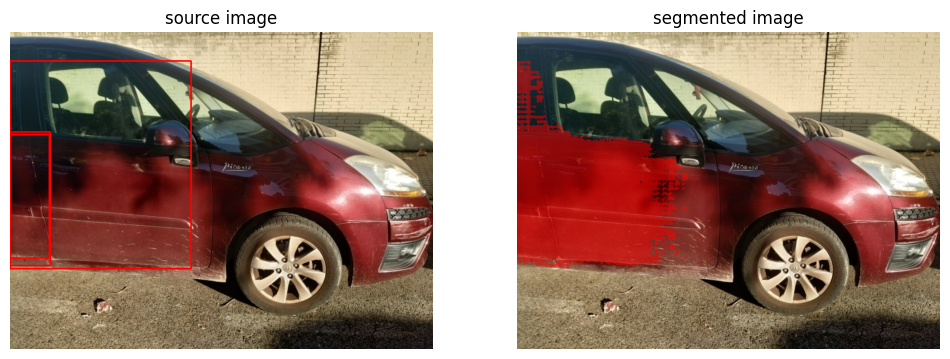

img_name: 5_m_2.jpg
boxes: [[  0 257  85 449]]
box: [  0 257  85 449]
mask shape: (3, 720, 957)
len masks: 1


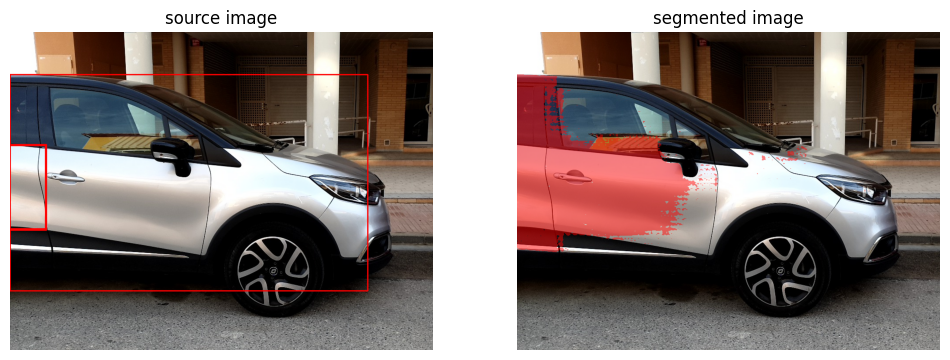

img_name: 10_m_0.jpg
boxes: []
len masks: 0
img_name: 23_m_2.jpg
boxes: []
len masks: 0
img_name: 57_m_2.jpg
boxes: []
len masks: 0
img_name: 33_m_0.jpg
boxes: [[  0 224  74 421]]
box: [  0 224  74 421]
mask shape: (3, 600, 800)
len masks: 1


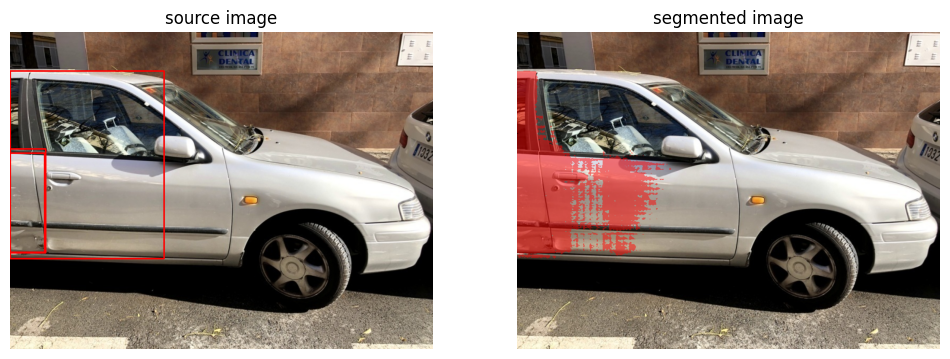

img_name: 56_m_2.jpg
boxes: []
len masks: 0
img_name: 21_m_2.jpg
boxes: []
len masks: 0
img_name: 48_m_0.jpg
boxes: [[ 52 503 -18 322]]
box: [ 52 503 -18 322]
mask shape: (3, 600, 800)
len masks: 1


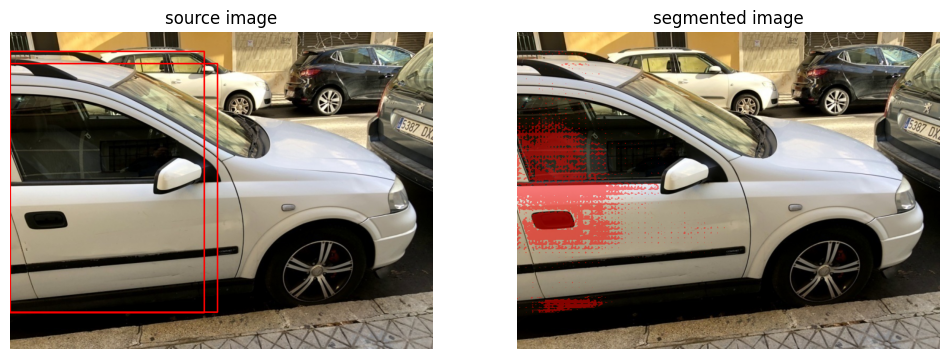

img_name: 8_m_2.jpg
boxes: []
len masks: 0
img_name: 52_m_2.jpg
boxes: []
len masks: 0
img_name: 25_m_0.jpg
boxes: []
len masks: 0
img_name: 37_m_0.jpg
boxes: []
len masks: 0
img_name: 22_m_0.jpg
boxes: [[ 69 452 -21 260]]
box: [ 69 452 -21 260]
mask shape: (3, 600, 800)
len masks: 1


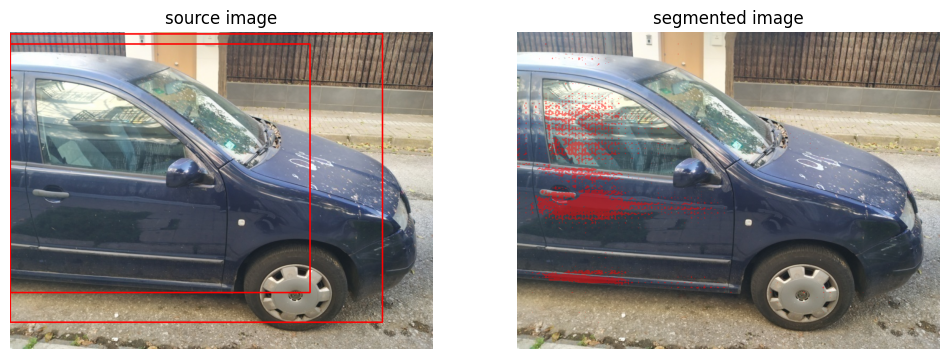

img_name: 30_m_1.jpg
boxes: []
len masks: 0
img_name: 47_m_2.jpg
boxes: []
len masks: 0
img_name: 82_m_2.jpg
boxes: [[  1 297  87 576]]
box: [  1 297  87 576]
mask shape: (3, 720, 957)
len masks: 1


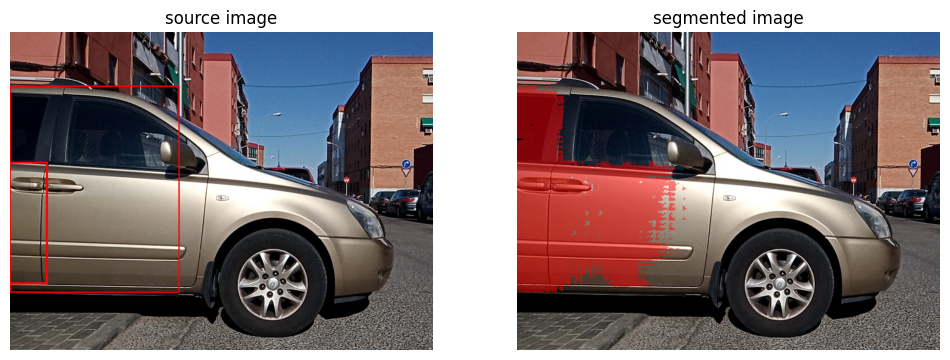

img_name: 47_m_0.jpg
boxes: [[  0 284 110 539]]
box: [  0 284 110 539]
mask shape: (3, 600, 800)
len masks: 1


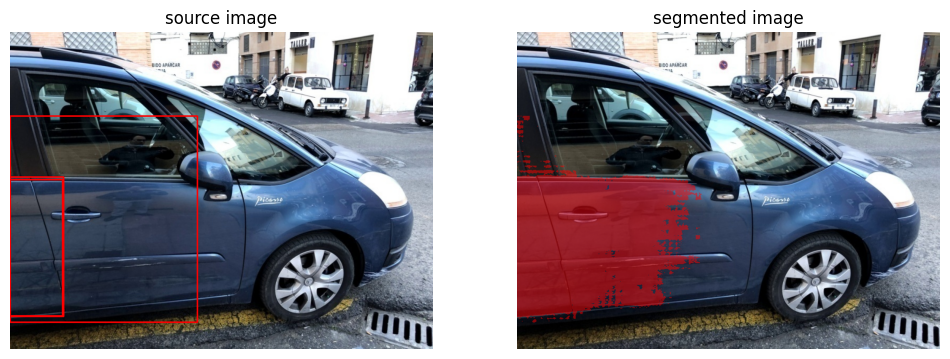

img_name: 9_m_2.jpg
boxes: []
len masks: 0
img_name: 44_m_1.jpg
boxes: []
len masks: 0
img_name: 25_m_1.jpg
boxes: []
len masks: 0
img_name: 26_m_2.jpg
boxes: [[ 27 536 -15 275]]
box: [ 27 536 -15 275]
mask shape: (3, 720, 957)
len masks: 1


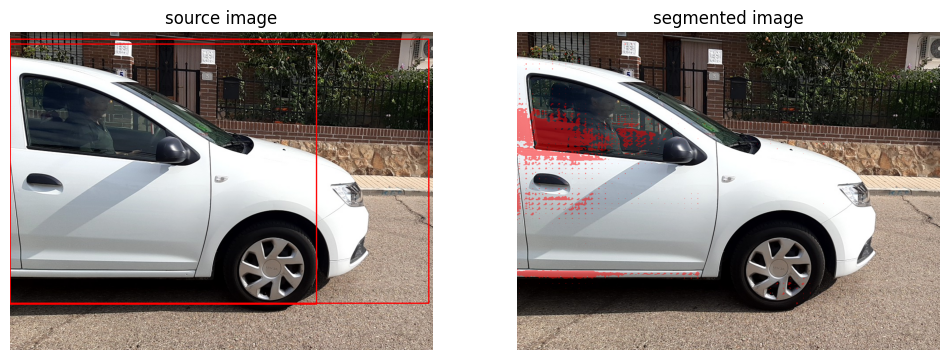

img_name: 10_m_2.jpg
boxes: []
len masks: 0
img_name: 74_m_2.jpg
boxes: []
len masks: 0
img_name: 43_m_1.jpg
boxes: [[755 420 840 291]]
box: [755 420 840 291]
mask shape: (3, 600, 800)
len masks: 1


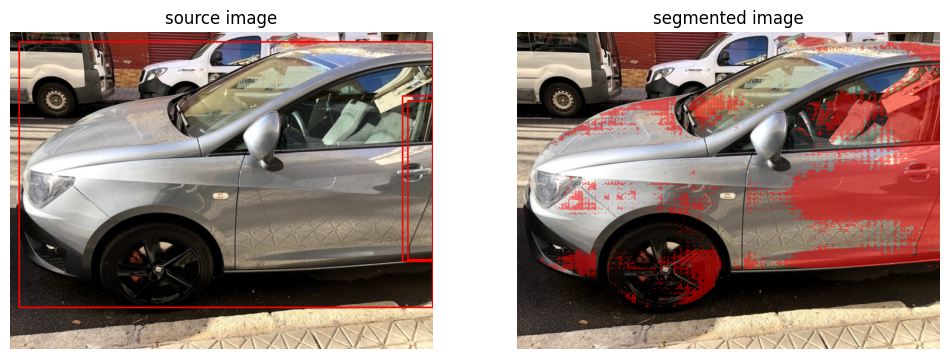

img_name: 68_m_2.jpg
boxes: []
len masks: 0
img_name: 10_m_1.jpg
boxes: [[798 431 742 247]]
box: [798 431 742 247]
mask shape: (3, 600, 800)
len masks: 1


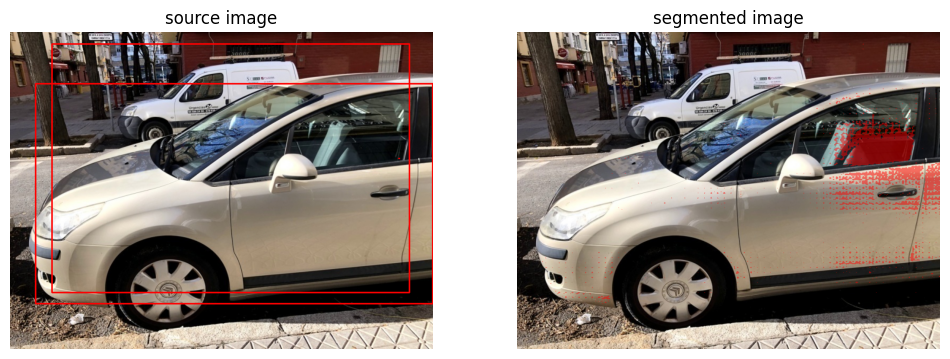

img_name: 96_m_2.jpg
boxes: []
len masks: 0
img_name: 35_m_1.jpg
boxes: []
len masks: 0
img_name: 15_m_0.jpg
boxes: []
len masks: 0
img_name: 72_m_2.jpg
boxes: []
len masks: 0
img_name: 77_m_2.jpg
boxes: []
len masks: 0
img_name: 38_m_0.jpg
boxes: []
len masks: 0
img_name: 48_m_1.jpg
boxes: [[752 507 818 249]]
box: [752 507 818 249]
mask shape: (3, 600, 800)
len masks: 1


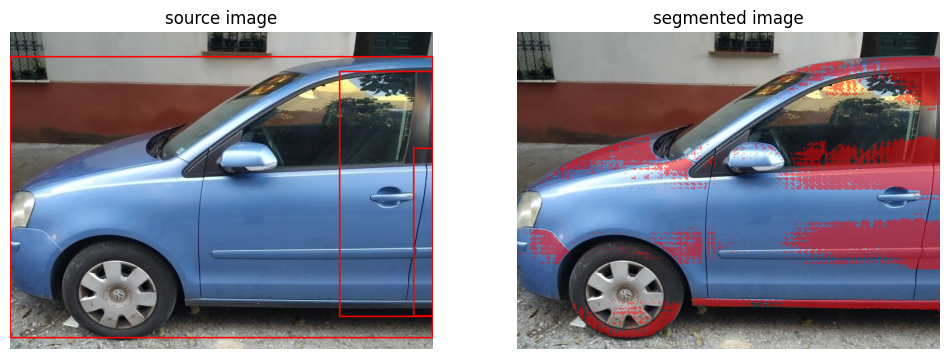

img_name: 13_m_1.jpg
boxes: [[798 441 696 257]]
box: [798 441 696 257]
mask shape: (3, 600, 800)
len masks: 1


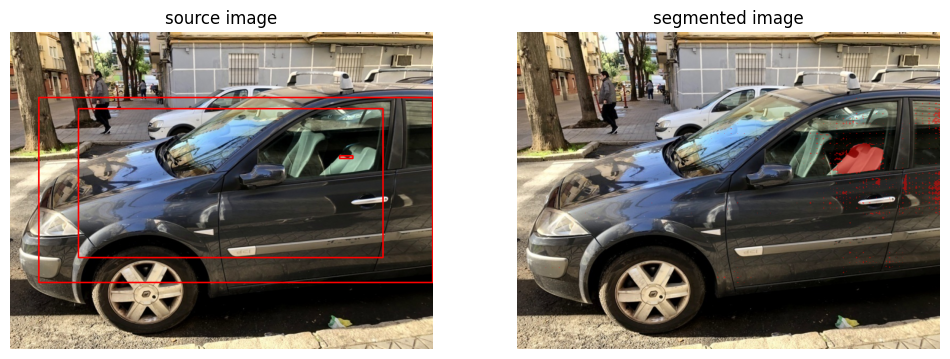

img_name: 33_m_2.jpg
boxes: [[  2 305 154 551]]
box: [  2 305 154 551]
mask shape: (3, 720, 957)
len masks: 1


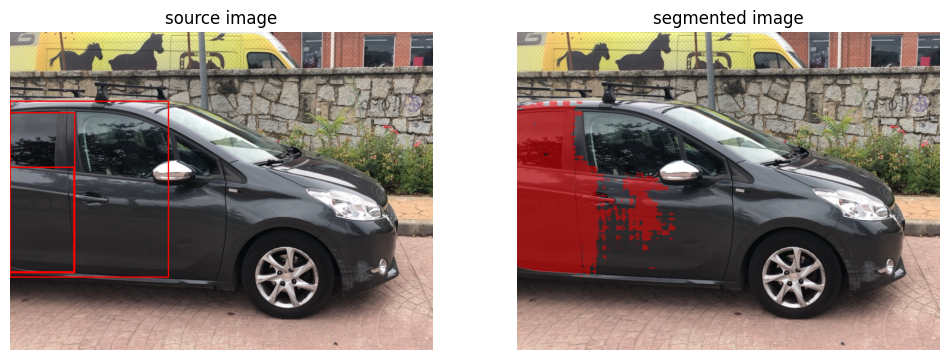

img_name: 33_m_1.jpg
boxes: [[761 458 825 327]]
box: [761 458 825 327]
mask shape: (3, 600, 800)
len masks: 1


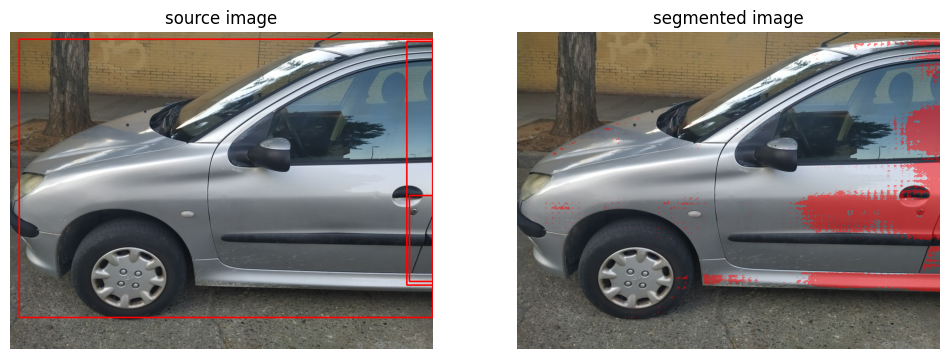

img_name: 28_m_0.jpg
boxes: [[  1 251  56 478]]
box: [  1 251  56 478]
mask shape: (3, 600, 800)
len masks: 1


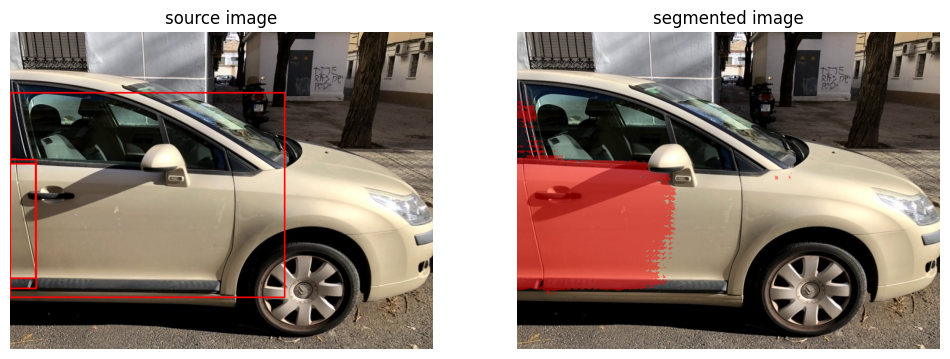

img_name: 15_m_2.jpg
boxes: []
len masks: 0
img_name: 95_m_2.jpg
boxes: []
len masks: 0
img_name: 36_m_0.jpg
boxes: [[ 42 414 -25 147]]
box: [ 42 414 -25 147]
mask shape: (3, 600, 800)
len masks: 1


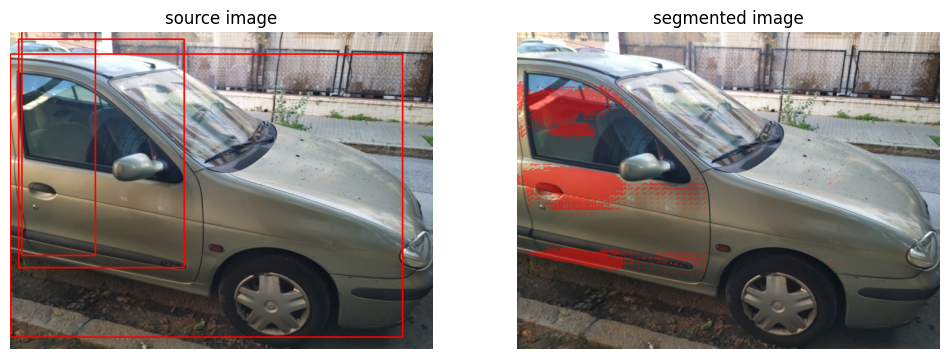

img_name: 51_m_1.jpg
boxes: [[693 474 823 254]]
box: [693 474 823 254]
mask shape: (3, 600, 800)
len masks: 1


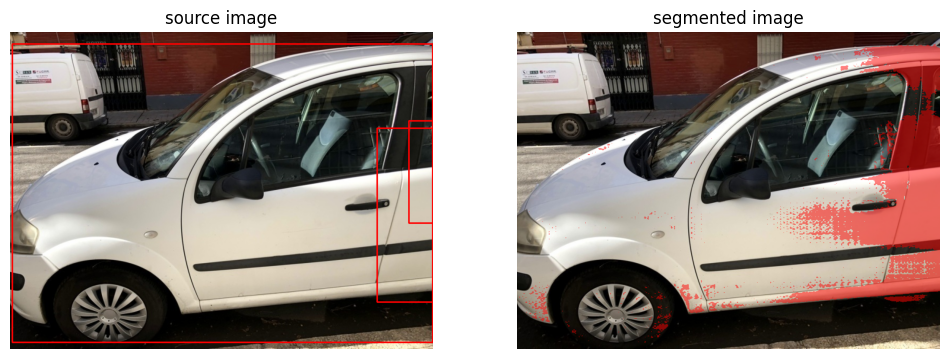

img_name: 15_m_1.jpg
boxes: [[695 503 814 291]]
box: [695 503 814 291]
mask shape: (3, 600, 800)
len masks: 1


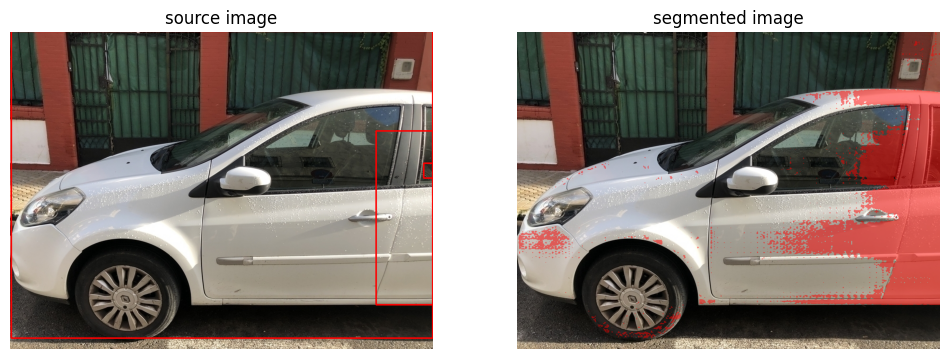

img_name: 91_m_2.jpg
boxes: []
len masks: 0
img_name: 73_m_2.jpg
boxes: []
len masks: 0
img_name: 81_m_2.jpg
boxes: [[  0 246  43 525]]
box: [  0 246  43 525]
mask shape: (3, 720, 957)
len masks: 1


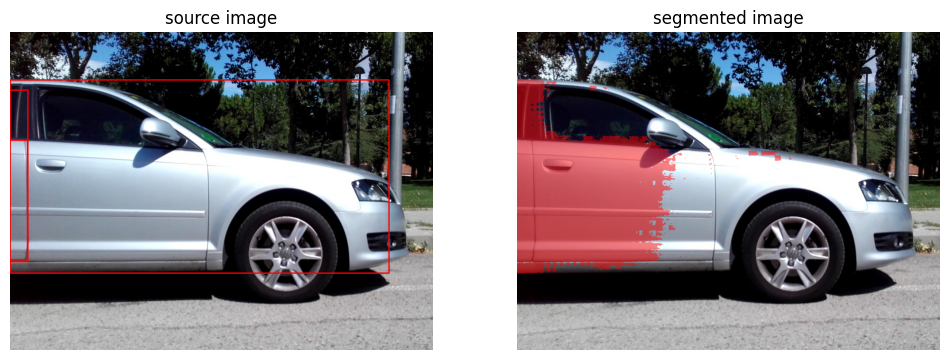

In [54]:
#Iterate images
import os
import numpy as np
box_annotator = sv.BoxAnnotator(color=sv.Color.RED, color_lookup=sv.ColorLookup.INDEX)
mask_annotator = sv.MaskAnnotator(color=sv.Color.RED, color_lookup=sv.ColorLookup.INDEX)
root_path = 'train/images'
images = os.listdir(root_path)
data = np.load('/content/img_dict.npy',allow_pickle=True)
data = data.item()
for img_name in images:
  if img_name not in data:
    continue
  image_path = os.path.join(root_path, img_name)
  image_bgr = cv2.imread(image_path)
  image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
  predictor.set_image(image_rgb)
  masks = []
  print('img_name:',img_name)
  boxes = data[img_name]
  boxes = np.array(boxes)
  print('boxes:',boxes)
  for box in boxes:
    print('box:',box)
    mask, scores, logits = predictor.predict(box=box,multimask_output=True)
    print('mask shape:',mask.shape)
    masks.append(mask)
  masks = np.array(masks)#[:, 0, :, :]
  print('len masks:',len(masks))
  for mask in masks:
    detections = sv.Detections(
        xyxy=sv.mask_to_xyxy(masks=mask),
        mask=mask.astype(bool))
    source_image = box_annotator.annotate(scene=image_bgr.copy(), detections=detections)
    segmented_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)
    sv.plot_images_grid(
    images=[source_image, segmented_image],
    grid_size=(1, 2),
    titles=['source image', 'segmented image'])